# Practice

In [1]:
import os
import math
import numpy as np
import tensorflow as tf

import PIL
from PIL import Image
import matplotlib.pyplot as plt
import skimage
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

import albumentations
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

print(tf.__version__)
print(np.__version__)
print(PIL.__version__)
print(skimage.__version__)
print(albumentations.__version__)

2.6.0
1.21.4
8.3.2
0.18.3
1.1.0


In [2]:
# Albumentation에서 다양한 augmentation 기법을 확률적으로 적용할 수 있게 해주는 Compose()의 활용
# imgaug의 Sometimes()와 유사한 기능
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
  if is_train:    # 훈련용 데이터일 경우
    return Compose([
                    HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                    RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              # 입력이미지를 224X224로 resize
                        width=224,
                        height=224
                        )
                    ])
  return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

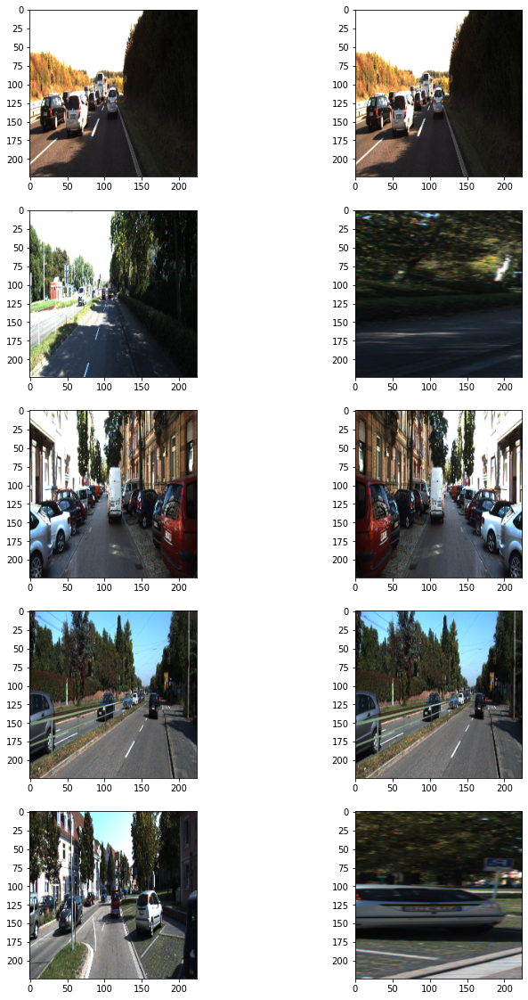

In [3]:
# augmentation 적용 및 확인
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
  
plt.show()

In [4]:
# tf.keras.utils.Sequence를 상속받은 generator 형태로 데이터를 구성
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [5]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

# U-net 구현 및 훈련

In [6]:
# U-Net 구현
from tensorflow.keras import layers, Model

def conv_block(x, filters):
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    return x

def crop_and_concat(encoder_layer, decoder_layer):
    """
    encoder_layer의 feature map을 decoder_layer와 concat하기 위해
    encoder_layer를 적절하게 crop합니다.
    """
    # static shape 정보를 이용 (입력 shape가 고정된 경우 사용 가능)
    encoder_shape = tf.keras.backend.int_shape(encoder_layer)
    decoder_shape = tf.keras.backend.int_shape(decoder_layer)
    
    # encoder_shape, decoder_shape는 (batch, height, width, channels) 형태입니다.
    crop_height = encoder_shape[1] - decoder_shape[1]
    crop_width = encoder_shape[2] - decoder_shape[2]
    
    # crop이 대칭으로 이루어지도록 위/아래, 좌/우 cropping 값을 계산합니다.
    cropping = (
        (crop_height // 2, crop_height - crop_height // 2),
        (crop_width // 2, crop_width - crop_width // 2)
    )
    
    # Cropping2D는 cropping 인자로 ((top, bottom), (left, right)) 튜플을 받습니다.
    cropped_encoder = layers.Cropping2D(cropping=cropping)(encoder_layer)
    return layers.Concatenate()([cropped_encoder, decoder_layer])

def build_model(input_shape=(224, 224, 3)):
    model = None
    # TODO: input_shape에 따라 U-Net을 만들어주세요
    # 이때 model은 fully convolutional해야 합니다.
    inputs = layers.Input(input_shape)

    # Encoder (Contracting Path)
    c1 = conv_block(inputs, 64)
    p1 = layers.MaxPooling2D((2, 2), strides=2)(c1)

    c2 = conv_block(p1, 128)
    p2 = layers.MaxPooling2D((2, 2), strides=2)(c2)

    c3 = conv_block(p2, 256)
    p3 = layers.MaxPooling2D((2, 2), strides=2)(c3)

    c4 = conv_block(p3, 512)
    p4 = layers.MaxPooling2D((2, 2), strides=2)(c4)

    # Bottleneck
    c5 = conv_block(p4, 1024)

    # Decoder (Expanding Path)
    u6 = layers.Conv2DTranspose(512, (2, 2), strides=2, padding="same")(c5)
    u6 = crop_and_concat(c4, u6)
    c6 = conv_block(u6, 512)

    u7 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(c6)
    u7 = crop_and_concat(c3, u7)
    c7 = conv_block(u7, 256)

    u8 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(c7)
    u8 = crop_and_concat(c2, u8)
    c8 = conv_block(u8, 128)

    u9 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(c8)
    u9 = crop_and_concat(c1, u9)
    c9 = conv_block(u9, 64)

    # Output Layer
    outputs = layers.Conv2D(1, (1, 1), activation="sigmoid")(c9)  # 2 클래스 segmentation map

    model = Model(inputs, outputs, name="U-Net")
    return model

build_model().summary()

Model: "U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 112, 112, 64) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

In [7]:
# 미리 학습된 모델 (참고용)
model_path = dir_path + '/seg_model_unet.h5' 

model = tf.keras.models.load_model(model_path)

model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 112, 112, 64) 0           conv2d_1[0][0]                   
_______________________________________________________________________________________

In [11]:
# 미리 학습된 모델 마지막 구조 확인하기
last_layer = model.layers[-1]
print("Last layer:", last_layer.name)
print("Activation function:", last_layer.activation)

print("Activation function name:", last_layer.activation.__name__)

Last layer: conv2d_23
Activation function: <function sigmoid at 0x7fb21e0138b0>
Activation function name: sigmoid


In [33]:
# callback 설정
from tensorflow.keras.callbacks import CSVLogger, ModelCheckpoint, EarlyStopping

# 현재 모델을 에폭마다 저장 (save_best_only=False)
checkpoint_current = ModelCheckpoint(
    filepath="./current_model.h5",       # 저장 파일명 (원하는 경로와 파일명으로 변경)
    save_weights_only=False,            # 전체 모델 저장
    save_freq='epoch',                  # 매 에폭마다 저장
    verbose=1
)

# 베스트 모델 저장 (val_loss 기준)
checkpoint_best = ModelCheckpoint(
    filepath="./best_model.h5",           # 저장 파일명 (원하는 경로와 파일명으로 변경)
    monitor='val_loss',                 # 모니터링할 metric (예: val_loss)
    save_best_only=True,                # 베스트 모델만 저장
    save_weights_only=False,            # 전체 모델 저장
    verbose=1
)

# 얼리스탑핑 (patience=20, 모니터는 val_loss)
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=20,
    verbose=1,
    restore_best_weights=True         # 학습 종료 후 베스트 가중치로 복원
)

# CSVLogger 콜백: 매 에폭의 loss와 metric을 기록
csv_logger = CSVLogger('./training_log.csv', append=True, separator=',')

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger]

# iou metric
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

In [34]:
train_generator

In [35]:
train_generator[0][1]

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 1., 1., 1.],
        [0., 0., 0., ..., 1., 1., 1.],
        [0., 0., 0., ..., 1., 1., 1.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1.

In [50]:
# 모델 학습
model = build_model()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric])
history = model.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

# model.save(model_path)  #학습한 모델을 저장해 주세요.

Epoch 1/200
11/11 [==============================] - 10s 785ms/step - loss: 0.6782 - iou_metric: 0.1221 - val_loss: 0.6503 - val_iou_metric: 0.0625

Epoch 00001: saving model to ./current_model.h5

Epoch 00001: val_loss improved from 0.65641 to 0.65027, saving model to ./best_model.h5
Epoch 2/200
11/11 [==============================] - 8s 721ms/step - loss: 0.6293 - iou_metric: 0.1591 - val_loss: 0.5968 - val_iou_metric: 0.0625

Epoch 00002: saving model to ./current_model.h5

Epoch 00002: val_loss improved from 0.65027 to 0.59681, saving model to ./best_model.h5
Epoch 3/200
11/11 [==============================] - 8s 731ms/step - loss: 0.5852 - iou_metric: 0.1193 - val_loss: 0.5637 - val_iou_metric: 0.0625

Epoch 00003: saving model to ./current_model.h5

Epoch 00003: val_loss improved from 0.59681 to 0.56372, saving model to ./best_model.h5
Epoch 4/200
11/11 [==============================] - 9s 744ms/step - loss: 0.4662 - iou_metric: 0.1307 - val_loss: 0.8805 - val_iou_metric: 0.06

11/11 [==============================] - 8s 733ms/step - loss: 0.1479 - iou_metric: 0.7021 - val_loss: 0.2040 - val_iou_metric: 0.7237

Epoch 00032: saving model to ./current_model.h5

Epoch 00032: val_loss did not improve from 0.19691
Epoch 33/200
11/11 [==============================] - 9s 741ms/step - loss: 0.1607 - iou_metric: 0.7104 - val_loss: 0.2057 - val_iou_metric: 0.7348

Epoch 00033: saving model to ./current_model.h5

Epoch 00033: val_loss did not improve from 0.19691
Epoch 34/200
11/11 [==============================] - 8s 725ms/step - loss: 0.1712 - iou_metric: 0.7090 - val_loss: 0.2000 - val_iou_metric: 0.7206

Epoch 00034: saving model to ./current_model.h5

Epoch 00034: val_loss did not improve from 0.19691
Epoch 35/200
11/11 [==============================] - 8s 724ms/step - loss: 0.1505 - iou_metric: 0.7077 - val_loss: 0.2192 - val_iou_metric: 0.6974

Epoch 00035: saving model to ./current_model.h5

Epoch 00035: val_loss did not improve from 0.19691
Epoch 36/200
11/1

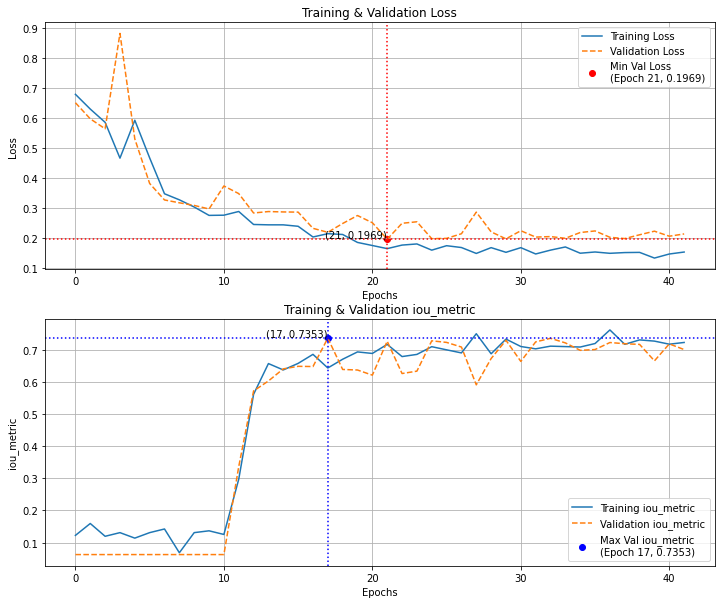

In [52]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요
loss_name = 'loss'
metric_name = 'iou_metric'
val_loss_name = 'val_' + loss_name
val_metric_name = 'val_' + metric_name

# ✅ 손실 및 정확도 값 가져오기
train_loss = history.history[loss_name]
val_loss = history.history[val_loss_name]
train_acc = history.history[metric_name]
val_acc = history.history[val_metric_name]

# ✅ Validation 기준 최하점 (Loss) & 최고점 (Accuracy) 찾기
min_val_loss_epoch = np.argmin(val_loss)  # 최소 validation loss의 epoch
min_val_loss = val_loss[min_val_loss_epoch]

max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

# ✅ 손실 (Loss) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss', linestyle='dashed')

# 최소 validation loss 지점 표시
plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss\n(Epoch {min_val_loss_epoch}, {min_val_loss:.4f})')
plt.text(min_val_loss_epoch, min_val_loss, f'({min_val_loss_epoch}, {min_val_loss:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_loss_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_loss, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid()

# ✅ 정확도 (Accuracy) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_acc, label=('Training ' + metric_name))
plt.plot(val_acc, label=('Validation ' + metric_name), linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val {metric_name}\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel(metric_name)
plt.title(f'Training & Validation {metric_name}')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()

In [54]:
# 모델 추가 학습

# 얼리스탑핑 (patience=30, 모니터는 val_loss)
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=30,
    verbose=1,
    restore_best_weights=True         # 학습 종료 후 베스트 가중치로 복원
)

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger]

model.compile(optimizer = Adam(5e-5), loss = 'binary_crossentropy', metrics=[iou_metric])

history = model.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

Epoch 1/200
11/11 [==============================] - 11s 805ms/step - loss: 0.1066 - iou_metric: 0.7663 - val_loss: 0.1521 - val_iou_metric: 0.7983

Epoch 00001: saving model to ./current_model.h5

Epoch 00001: val_loss did not improve from 0.13955
Epoch 2/200
11/11 [==============================] - 8s 734ms/step - loss: 0.0929 - iou_metric: 0.7937 - val_loss: 0.1793 - val_iou_metric: 0.7848

Epoch 00002: saving model to ./current_model.h5

Epoch 00002: val_loss did not improve from 0.13955
Epoch 3/200
11/11 [==============================] - 8s 726ms/step - loss: 0.0937 - iou_metric: 0.7747 - val_loss: 0.1624 - val_iou_metric: 0.7758

Epoch 00003: saving model to ./current_model.h5

Epoch 00003: val_loss did not improve from 0.13955
Epoch 4/200
11/11 [==============================] - 8s 722ms/step - loss: 0.0881 - iou_metric: 0.8080 - val_loss: 0.1760 - val_iou_metric: 0.7605

Epoch 00004: saving model to ./current_model.h5

Epoch 00004: val_loss did not improve from 0.13955
Epoch 5


Epoch 00033: val_loss did not improve from 0.12378
Epoch 34/200
11/11 [==============================] - 8s 728ms/step - loss: 0.0858 - iou_metric: 0.7995 - val_loss: 0.1741 - val_iou_metric: 0.7718

Epoch 00034: saving model to ./current_model.h5

Epoch 00034: val_loss did not improve from 0.12378
Epoch 35/200
11/11 [==============================] - 8s 732ms/step - loss: 0.0750 - iou_metric: 0.8247 - val_loss: 0.1937 - val_iou_metric: 0.7769

Epoch 00035: saving model to ./current_model.h5

Epoch 00035: val_loss did not improve from 0.12378
Epoch 36/200
11/11 [==============================] - 8s 724ms/step - loss: 0.0798 - iou_metric: 0.7896 - val_loss: 0.1639 - val_iou_metric: 0.7900

Epoch 00036: saving model to ./current_model.h5

Epoch 00036: val_loss did not improve from 0.12378
Epoch 37/200
11/11 [==============================] - 8s 721ms/step - loss: 0.0766 - iou_metric: 0.7938 - val_loss: 0.1801 - val_iou_metric: 0.7776

Epoch 00037: saving model to ./current_model.h5

Epo


Epoch 00066: saving model to ./current_model.h5

Epoch 00066: val_loss did not improve from 0.12219
Epoch 67/200
11/11 [==============================] - 8s 721ms/step - loss: 0.0813 - iou_metric: 0.8144 - val_loss: 0.2021 - val_iou_metric: 0.7669

Epoch 00067: saving model to ./current_model.h5

Epoch 00067: val_loss did not improve from 0.12219
Epoch 68/200
11/11 [==============================] - 8s 726ms/step - loss: 0.0731 - iou_metric: 0.8334 - val_loss: 0.2194 - val_iou_metric: 0.7670

Epoch 00068: saving model to ./current_model.h5

Epoch 00068: val_loss did not improve from 0.12219
Epoch 69/200
11/11 [==============================] - 8s 729ms/step - loss: 0.0801 - iou_metric: 0.7898 - val_loss: 0.2494 - val_iou_metric: 0.7238

Epoch 00069: saving model to ./current_model.h5

Epoch 00069: val_loss did not improve from 0.12219
Epoch 70/200
11/11 [==============================] - 8s 725ms/step - loss: 0.0801 - iou_metric: 0.8323 - val_loss: 0.2302 - val_iou_metric: 0.7445

Epo

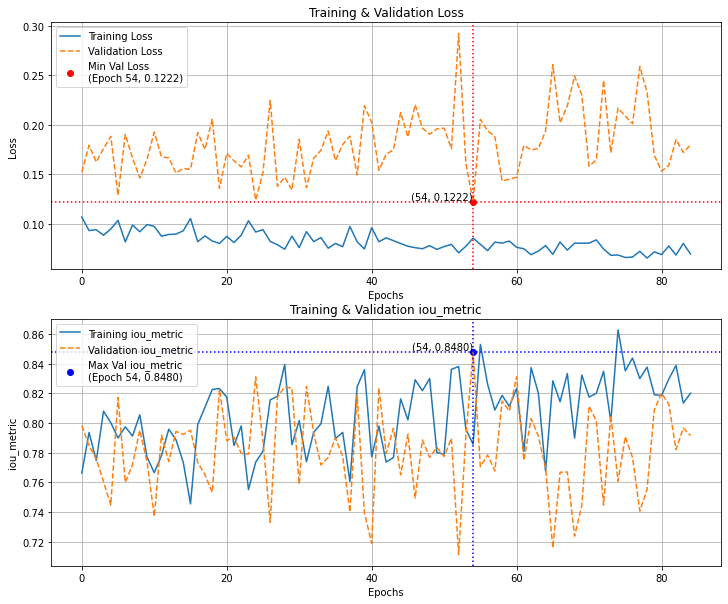

In [55]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요
loss_name = 'loss'
metric_name = 'iou_metric'
val_loss_name = 'val_' + loss_name
val_metric_name = 'val_' + metric_name

# ✅ 손실 및 정확도 값 가져오기
train_loss = history.history[loss_name]
val_loss = history.history[val_loss_name]
train_acc = history.history[metric_name]
val_acc = history.history[val_metric_name]

# ✅ Validation 기준 최하점 (Loss) & 최고점 (Accuracy) 찾기
min_val_loss_epoch = np.argmin(val_loss)  # 최소 validation loss의 epoch
min_val_loss = val_loss[min_val_loss_epoch]

max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

# ✅ 손실 (Loss) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss', linestyle='dashed')

# 최소 validation loss 지점 표시
plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss\n(Epoch {min_val_loss_epoch}, {min_val_loss:.4f})')
plt.text(min_val_loss_epoch, min_val_loss, f'({min_val_loss_epoch}, {min_val_loss:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_loss_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_loss, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid()

# ✅ 정확도 (Accuracy) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_acc, label=('Training ' + metric_name))
plt.plot(val_acc, label=('Validation ' + metric_name), linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val {metric_name}\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel(metric_name)
plt.title(f'Training & Validation {metric_name}')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()

In [ ]:
# 저장된 모델 불러오기
from tensorflow.keras.models import load_model

# 1. 저장된 모델 불러오기 (custom_objects에 iou_metric 추가)
model = load_model('./best_model.h5', custom_objects={'iou_metric': iou_metric})

# 2. 모델 컴파일 (이전에 사용했던 optimizer, loss, metric 사용)
model.compile(optimizer=Adam(1e-4), loss='binary_crossentropy', metrics=[iou_metric])

# 이어서 학습을 진행하기 위해, 이전 에폭 수를 지정 (예: 50 에폭 학습 후)
initial_epoch = 50  # 이전에 학습한 에폭 수에 맞게 수정

# 3. 콜백 설정 (CSVLogger는 append=True로 기존 로그에 이어서 기록)
from tensorflow.keras.callbacks import CSVLogger, ModelCheckpoint, EarlyStopping

checkpoint_current = ModelCheckpoint(
    filepath="./current_model.h5",
    save_weights_only=False,
    save_freq='epoch',
    verbose=1
)

checkpoint_best = ModelCheckpoint(
    filepath="./best_model.h5",
    monitor='val_loss',
    save_best_only=True,
    save_weights_only=False,
    verbose=1
)

early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=20,
    verbose=1,
    restore_best_weights=True
)

csv_logger = CSVLogger('./training_log.csv', append=True, separator=',')

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger]

# 4. 이어서 학습 진행
history2 = model.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=150,             # 총 에폭 수 (예: 150 에폭까지 학습)
    initial_epoch=initial_epoch,  # 이전 학습에서 이어서 시작
    callbacks=callbacks
)


In [12]:
# 저장된 모델 불러오기
from tensorflow.keras.models import load_model

# iou metric
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

# 1. 저장된 모델 불러오기 (custom_objects에 iou_metric 추가)
model = load_model('./best_model.h5', custom_objects={'iou_metric': iou_metric})

model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_13 (InputLayer)           [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_228 (Conv2D)             (None, 224, 224, 64) 1792        input_13[0][0]                   
__________________________________________________________________________________________________
conv2d_229 (Conv2D)             (None, 224, 224, 64) 36928       conv2d_228[0][0]                 
__________________________________________________________________________________________________
max_pooling2d_48 (MaxPooling2D) (None, 112, 112, 64) 0           conv2d_229[0][0]                 
______________________________________________________________________________________________

In [13]:
# 세그멘테이션 이미지 만들기
def get_output(model, preproc, image_path, output_path):
     origin_img = imread(image_path)
     data = {"image":origin_img}
     processed = preproc(**data)
     output = model(np.expand_dims(processed["image"]/255,axis=0))
     output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
     output = Image.fromarray(output)
     background = Image.fromarray(origin_img).convert('RGBA')
     output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
     output = Image.blend(background, output, alpha=0.5)
     output.show()
     return output

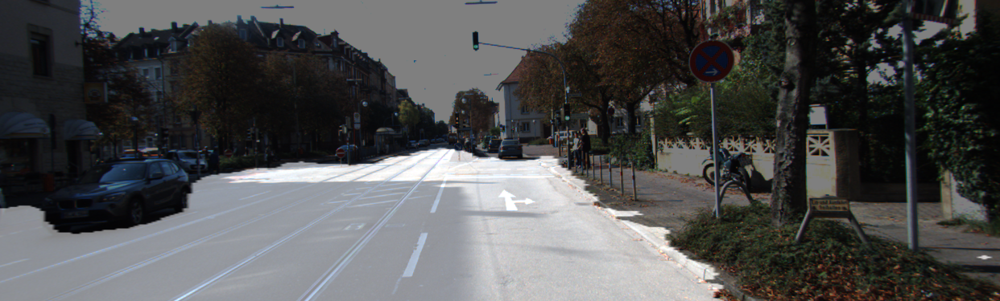

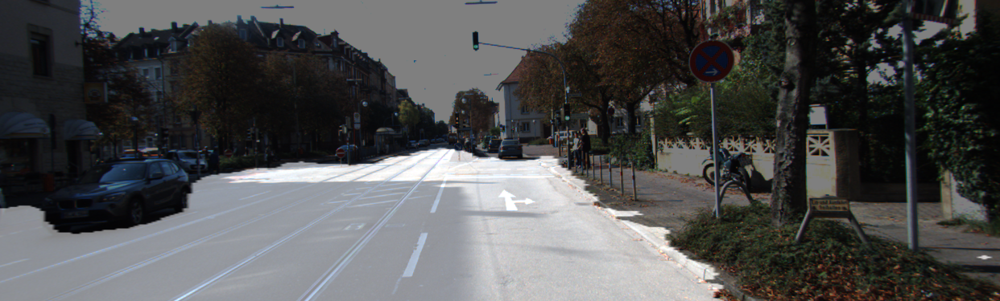

In [14]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

In [49]:
# iou 계산
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction).sum() # intersection을 구하는 코드를 작성해주세요.
    union = np.logical_or(target, prediction).sum() # Union을 구하는 코드를 작성해주세요.
    iou_score = float(intersection) / float(union) if union != 0 else 1.0 # iou 스코어를 구하되 결과값을 float로 만들어주세요!
    print('IoU : %f' % iou_score )
    return iou_score

In [50]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

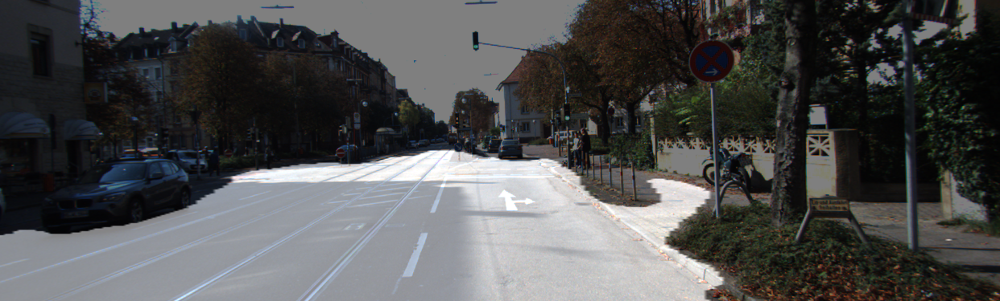

IoU : 0.897818


0.8978176775417853

In [51]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
output, prediction, target = get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

In [18]:
# IOU 기가 막히다.
# 더욱 다양한 샘플에 대해 정성, 정량 평가하는 것이 필요하다.

# U-net++ 구현 및 훈련

In [8]:
# U-net++(neseted_U-net) 구현하기
from tensorflow.keras import layers, Model
import tensorflow as tf

def conv_block(x, filters):
    """기본 컨볼루션 블록"""
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.BatchNormalization()(x)
    return x

def crop_and_concat(encoder_layer, decoder_layer):
    """
    encoder_layer의 feature map을 decoder_layer와 concat하기 위해
    encoder_layer를 적절하게 crop합니다.
    """
    # static shape 정보를 이용 (입력 shape가 고정된 경우 사용 가능)
    encoder_shape = tf.keras.backend.int_shape(encoder_layer)
    decoder_shape = tf.keras.backend.int_shape(decoder_layer)
    
    # encoder_shape, decoder_shape는 (batch, height, width, channels) 형태입니다.
    crop_height = encoder_shape[1] - decoder_shape[1]
    crop_width = encoder_shape[2] - decoder_shape[2]
    
    # crop이 대칭으로 이루어지도록 위/아래, 좌/우 cropping 값을 계산합니다.
    cropping = (
        (crop_height // 2, crop_height - crop_height // 2),
        (crop_width // 2, crop_width - crop_width // 2)
    )
    
    # Cropping2D는 cropping 인자로 ((top, bottom), (left, right)) 튜플을 받습니다.
    if crop_height > 0 or crop_width > 0:
        cropped_encoder = layers.Cropping2D(cropping=cropping)(encoder_layer)
    else:
        cropped_encoder = encoder_layer
    
    return layers.Concatenate()([cropped_encoder, decoder_layer])

def build_unet_plus_plus(input_shape=(224, 224, 3), num_classes=1, deep_supervision=True):
    """
    U-Net++ 모델을 구현합니다.
    
    Args:
        input_shape: 입력 이미지의 shape (height, width, channels)
        num_classes: 출력 클래스 수 (이진 분할의 경우 1)
        deep_supervision: 깊은 감독 사용 여부
        
    Returns:
        U-Net++ 모델
    """
    inputs = layers.Input(input_shape)
    
    # 노드 저장용 딕셔너리 (X_i_j 형식: i는 다운샘플링 레벨, j는 해당 레벨에서의 노드 인덱스)
    nodes = {}
    
    # Encoder (Contracting Path)
    nodes['X_0_0'] = conv_block(inputs, 64)
    p1 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_0_0'])
    
    nodes['X_1_0'] = conv_block(p1, 128)
    p2 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_1_0'])
    
    nodes['X_2_0'] = conv_block(p2, 256)
    p3 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_2_0'])
    
    nodes['X_3_0'] = conv_block(p3, 512)
    p4 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_3_0'])
    
    # Bottleneck
    nodes['X_4_0'] = conv_block(p4, 1024)
    
    # Decoder (Expanding Path with Nested Dense Skip Connections)
    
    # 레벨 3 (첫 번째 업샘플링 레벨)
    up1 = layers.Conv2DTranspose(512, (2, 2), strides=2, padding="same")(nodes['X_4_0'])
    nodes['X_3_1'] = conv_block(crop_and_concat(nodes['X_3_0'], up1), 512)
    
    # 레벨 2 (두 번째 업샘플링 레벨)
    up2_0 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(nodes['X_3_0'])
    nodes['X_2_1'] = conv_block(crop_and_concat(nodes['X_2_0'], up2_0), 256)
    
    up2_1 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(nodes['X_3_1'])
    merged = crop_and_concat(nodes['X_2_0'], up2_1)
    merged = crop_and_concat(nodes['X_2_1'], merged)
    nodes['X_2_2'] = conv_block(merged, 256)
    
    # 레벨 1 (세 번째 업샘플링 레벨)
    up3_0 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_0'])
    nodes['X_1_1'] = conv_block(crop_and_concat(nodes['X_1_0'], up3_0), 128)
    
    up3_1 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_1'])
    merged = crop_and_concat(nodes['X_1_0'], up3_1)
    merged = crop_and_concat(nodes['X_1_1'], merged)
    nodes['X_1_2'] = conv_block(merged, 128)
    
    up3_2 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_2'])
    merged = crop_and_concat(nodes['X_1_0'], up3_2)
    merged = crop_and_concat(nodes['X_1_1'], merged)
    merged = crop_and_concat(nodes['X_1_2'], merged)
    nodes['X_1_3'] = conv_block(merged, 128)
    
    # 레벨 0 (마지막 업샘플링 레벨)
    up4_0 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_0'])
    nodes['X_0_1'] = conv_block(crop_and_concat(nodes['X_0_0'], up4_0), 64)
    
    up4_1 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_1'])
    merged = crop_and_concat(nodes['X_0_0'], up4_1)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    nodes['X_0_2'] = conv_block(merged, 64)
    
    up4_2 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_2'])
    merged = crop_and_concat(nodes['X_0_0'], up4_2)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    merged = crop_and_concat(nodes['X_0_2'], merged)
    nodes['X_0_3'] = conv_block(merged, 64)
    
    up4_3 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_3'])
    merged = crop_and_concat(nodes['X_0_0'], up4_3)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    merged = crop_and_concat(nodes['X_0_2'], merged)
    merged = crop_and_concat(nodes['X_0_3'], merged)
    nodes['X_0_4'] = conv_block(merged, 64)
    
    # 출력 레이어 설정
    activation = 'sigmoid' if num_classes == 1 else 'softmax'
    
    # 깊은 감독(Deep Supervision) 구현
    if deep_supervision:
        output1 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output1')(nodes['X_0_1'])
        output2 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output2')(nodes['X_0_2'])
        output3 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output3')(nodes['X_0_3'])
        output4 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output4')(nodes['X_0_4'])
        
        model = Model(inputs=inputs, outputs=[output1, output2, output3, output4], name="unet_plus_plus")
    else:
        # 깊은 감독을 사용하지 않는 경우 최종 출력만 사용
        outputs = layers.Conv2D(num_classes, (1, 1), activation=activation)(nodes['X_0_4'])
        model = Model(inputs=inputs, outputs=outputs, name="unet_plus_plus")
        
    return model

# 모델 생성 및 요약 출력
model_unet_plus_plus = build_unet_plus_plus(input_shape=(224, 224, 3), num_classes=1, deep_supervision=True)
model_unet_plus_plus.summary()


Model: "unet_plus_plus"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_19 (Conv2D)              (None, 224, 224, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 224, 224, 64) 256         conv2d_19[0][0]                  
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 224, 224, 64) 36928       batch_normalization[0][0]        
_____________________________________________________________________________________

In [27]:
# callback 설정
from tensorflow.keras.callbacks import CSVLogger, ModelCheckpoint, EarlyStopping

# 현재 모델을 에폭마다 저장 (save_best_only=False)
checkpoint_current = ModelCheckpoint(
    filepath="./current_model_unet_plus_plus.h5",       # 저장 파일명 (원하는 경로와 파일명으로 변경)
    save_weights_only=False,            # 전체 모델 저장
    save_freq='epoch',                  # 매 에폭마다 저장
    verbose=1
)

# 베스트 모델 저장 (val_loss 기준)
checkpoint_best = ModelCheckpoint(
    filepath="./best_model_unet_plus_plus.h5",           # 저장 파일명 (원하는 경로와 파일명으로 변경)
    monitor='val_loss',                 # 모니터링할 metric (예: val_loss)
    save_best_only=True,                # 베스트 모델만 저장
    save_weights_only=False,            # 전체 모델 저장
    verbose=1
)

# 얼리스탑핑 (patience=20, 모니터는 val_loss)
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=20,
    verbose=1,
    restore_best_weights=True         # 학습 종료 후 베스트 가중치로 복원
)

# CSVLogger 콜백: 매 에폭의 loss와 metric을 기록
csv_logger = CSVLogger('./training_log_unet_plus_plus.csv', append=True, separator=',')

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger]

# iou metric
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

In [28]:
# 모델 학습
model_unet_plus_plus.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric])
history = model_unet_plus_plus.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

Epoch 1/200


ResourceExhaustedError:  OOM when allocating tensor with shape[16,320,224,224] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[node gradient_tape/unet_plus_plus/conv2d_107/Conv2D/Conv2DBackpropInput (defined at tmp/ipykernel_31/4249082719.py:3) ]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.
 [Op:__inference_train_function_18445]

Function call stack:
train_function


In [29]:
# 아웃 오브 메모리..
# 배치사이즈를 절반으로 줄여보자. (16 -> 8)
# tf.keras.utils.Sequence를 상속받은 generator 형태로 데이터를 구성
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=8,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes
    
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

In [30]:
# 모델 학습
model_unet_plus_plus.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric])
history = model_unet_plus_plus.fit(
    train_generator,
    validation_data=test_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

Epoch 1/200
22/22 [==============================] - 46s 1s/step - loss: 2.5825 - output1_loss: 0.7103 - output2_loss: 0.6493 - output3_loss: 0.6337 - output4_loss: 0.5892 - output1_iou_metric: 0.3054 - output2_iou_metric: 0.3527 - output3_iou_metric: 0.3541 - output4_iou_metric: 0.3859 - val_loss: 2.8574 - val_output1_loss: 0.6745 - val_output2_loss: 0.7224 - val_output3_loss: 0.7393 - val_output4_loss: 0.7212 - val_output1_iou_metric: 0.1456 - val_output2_iou_metric: 0.2441 - val_output3_iou_metric: 0.2302 - val_output4_iou_metric: 0.2492

Epoch 00001: saving model to ./current_model_unet_plus_plus.h5

Epoch 00001: val_loss improved from inf to 2.85744, saving model to ./best_model_unet_plus_plus.h5
Epoch 2/200
22/22 [==============================] - 24s 1s/step - loss: 2.0646 - output1_loss: 0.5543 - output2_loss: 0.5178 - output3_loss: 0.5099 - output4_loss: 0.4826 - output1_iou_metric: 0.4003 - output2_iou_metric: 0.4326 - output3_iou_metric: 0.4292 - output4_iou_metric: 0.4565 -


Epoch 00012: saving model to ./current_model_unet_plus_plus.h5

Epoch 00012: val_loss did not improve from 1.96936
Epoch 13/200
22/22 [==============================] - 24s 1s/step - loss: 1.1901 - output1_loss: 0.3590 - output2_loss: 0.3015 - output3_loss: 0.2774 - output4_loss: 0.2522 - output1_iou_metric: 0.5297 - output2_iou_metric: 0.5925 - output3_iou_metric: 0.5822 - output4_iou_metric: 0.6153 - val_loss: 2.0774 - val_output1_loss: 0.6090 - val_output2_loss: 0.5182 - val_output3_loss: 0.4894 - val_output4_loss: 0.4608 - val_output1_iou_metric: 0.1964 - val_output2_iou_metric: 0.2136 - val_output3_iou_metric: 0.1405 - val_output4_iou_metric: 0.2835

Epoch 00013: saving model to ./current_model_unet_plus_plus.h5

Epoch 00013: val_loss did not improve from 1.96936
Epoch 14/200
22/22 [==============================] - 24s 1s/step - loss: 1.1713 - output1_loss: 0.3517 - output2_loss: 0.2952 - output3_loss: 0.2719 - output4_loss: 0.2524 - output1_iou_metric: 0.5751 - output2_iou_metr

22/22 [==============================] - 24s 1s/step - loss: 0.8212 - output1_loss: 0.2771 - output2_loss: 0.2009 - output3_loss: 0.1803 - output4_loss: 0.1630 - output1_iou_metric: 0.5906 - output2_iou_metric: 0.6862 - output3_iou_metric: 0.6840 - output4_iou_metric: 0.7103 - val_loss: 1.1166 - val_output1_loss: 0.2993 - val_output2_loss: 0.3069 - val_output3_loss: 0.2653 - val_output4_loss: 0.2450 - val_output1_iou_metric: 0.6322 - val_output2_iou_metric: 0.6192 - val_output3_iou_metric: 0.6881 - val_output4_iou_metric: 0.6940

Epoch 00037: saving model to ./current_model_unet_plus_plus.h5

Epoch 00037: val_loss improved from 1.15904 to 1.11659, saving model to ./best_model_unet_plus_plus.h5
Epoch 38/200
22/22 [==============================] - 23s 1s/step - loss: 0.8692 - output1_loss: 0.2968 - output2_loss: 0.2103 - output3_loss: 0.1880 - output4_loss: 0.1741 - output1_iou_metric: 0.5719 - output2_iou_metric: 0.6670 - output3_iou_metric: 0.6409 - output4_iou_metric: 0.6590 - val_lo

22/22 [==============================] - 24s 1s/step - loss: 0.6507 - output1_loss: 0.2345 - output2_loss: 0.1579 - output3_loss: 0.1355 - output4_loss: 0.1228 - output1_iou_metric: 0.6129 - output2_iou_metric: 0.6754 - output3_iou_metric: 0.6971 - output4_iou_metric: 0.7109 - val_loss: 0.9784 - val_output1_loss: 0.2802 - val_output2_loss: 0.2313 - val_output3_loss: 0.2524 - val_output4_loss: 0.2145 - val_output1_iou_metric: 0.5959 - val_output2_iou_metric: 0.7018 - val_output3_iou_metric: 0.6422 - val_output4_iou_metric: 0.6527

Epoch 00061: saving model to ./current_model_unet_plus_plus.h5

Epoch 00061: val_loss did not improve from 0.88556
Epoch 62/200
22/22 [==============================] - 24s 1s/step - loss: 0.6664 - output1_loss: 0.2333 - output2_loss: 0.1625 - output3_loss: 0.1405 - output4_loss: 0.1301 - output1_iou_metric: 0.6426 - output2_iou_metric: 0.7088 - output3_iou_metric: 0.6853 - output4_iou_metric: 0.7307 - val_loss: 1.1261 - val_output1_loss: 0.3710 - val_output2_

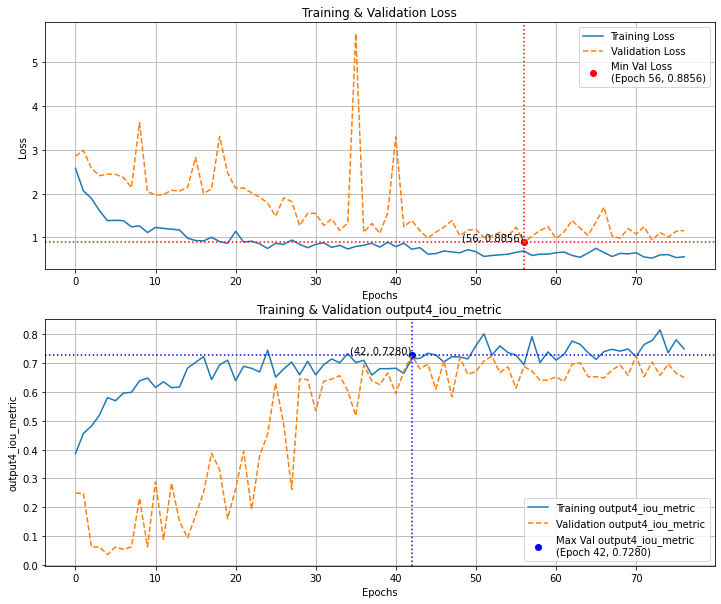

In [32]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요
loss_name = 'loss'
metric_name = 'output4_iou_metric'
val_loss_name = 'val_' + loss_name
val_metric_name = 'val_' + metric_name

# ✅ 손실 및 정확도 값 가져오기
train_loss = history.history[loss_name]
val_loss = history.history[val_loss_name]
train_acc = history.history[metric_name]
val_acc = history.history[val_metric_name]

# ✅ Validation 기준 최하점 (Loss) & 최고점 (Accuracy) 찾기
min_val_loss_epoch = np.argmin(val_loss)  # 최소 validation loss의 epoch
min_val_loss = val_loss[min_val_loss_epoch]

max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

# ✅ 손실 (Loss) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss', linestyle='dashed')

# 최소 validation loss 지점 표시
plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss\n(Epoch {min_val_loss_epoch}, {min_val_loss:.4f})')
plt.text(min_val_loss_epoch, min_val_loss, f'({min_val_loss_epoch}, {min_val_loss:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_loss_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_loss, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid()

# ✅ 정확도 (Accuracy) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_acc, label=('Training ' + metric_name))
plt.plot(val_acc, label=('Validation ' + metric_name), linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val {metric_name}\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel(metric_name)
plt.title(f'Training & Validation {metric_name}')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()

# 시각화를 통한 정성평가 POC

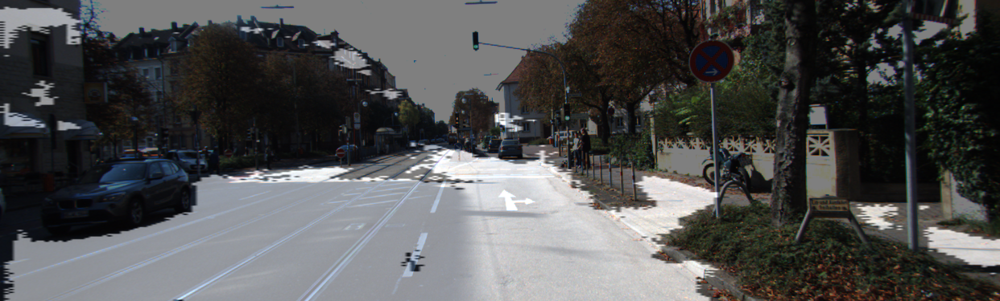

IoU : 0.798723


0.7987231413468799

In [52]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))[0]
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
output, prediction, target = get_output(
     model_unet_plus_plus, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

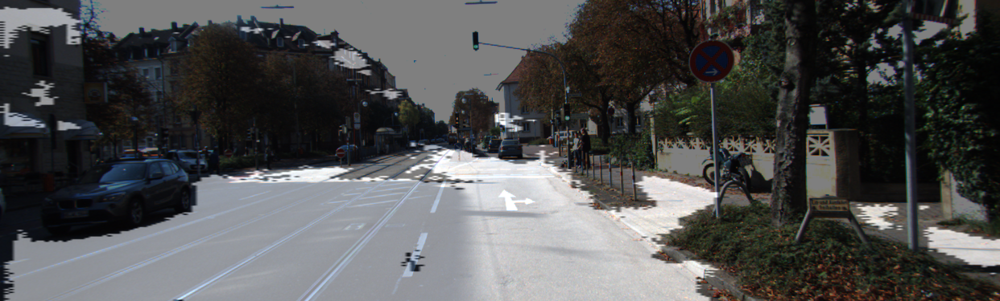

In [53]:
output

In [54]:
prediction

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 1., 1., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [0., 1., 1., ..., 0., 0., 0.]])

In [55]:
target

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [1, 1, 1, ..., 0, 0, 0],
       [1, 1, 1, ..., 0, 0, 0],
       [1, 1, 1, ..., 0, 0, 0]], dtype=uint8)

In [56]:
type(output)

PIL.Image.Image

In [57]:
np.array(output)

array([[[ 34,  39,  41, 255],
        [ 34,  39,  39, 255],
        [ 36,  39,  38, 255],
        ...,
        [ 28,  20,  18, 255],
        [ 27,  20,  19, 255],
        [ 25,  21,  19, 255]],

       [[ 33,  39,  42, 255],
        [ 33,  39,  44, 255],
        [ 36,  39,  44, 255],
        ...,
        [ 29,  21,  18, 255],
        [ 27,  21,  17, 255],
        [ 23,  22,  17, 255]],

       [[ 37,  38,  41, 255],
        [ 36,  39,  45, 255],
        [ 37,  39,  46, 255],
        ...,
        [ 28,  22,  16, 255],
        [ 26,  22,  14, 255],
        [ 25,  22,  15, 255]],

       ...,

       [[ 13,  16,  21, 255],
        [ 13,  17,  22, 255],
        [ 13,  18,  22, 255],
        ...,
        [ 80,  26,  19, 255],
        [ 56,  20,  19, 255],
        [ 41,  15,  15, 255]],

       [[ 13,  16,  21, 255],
        [ 12,  18,  22, 255],
        [ 13,  18,  22, 255],
        ...,
        [ 83,  29,  19, 255],
        [ 64,  28,  17, 255],
        [ 43,  28,  21, 255]],

       [[ 15

In [58]:
np.array(output).shape, prediction.shape, target.shape

((375, 1242, 4), (224, 224), (224, 224))

In [59]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))[0]
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
#     output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return origin_img, output, prediction, target
    else:
        return origin_img, output, prediction, _

# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
origin_img, output, prediction, target = get_output(
     model_unet_plus_plus, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
     label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
 )

calculate_iou_score(target, prediction)

IoU : 0.798723


0.7987231413468799

In [60]:
origin_img.shape, prediction.shape, target.shape

((375, 1242, 3), (224, 224), (224, 224))

In [61]:
import albumentations as A

resized_img = A.Resize(224, 224)(image=origin_img)["image"]
resized_img.shape

(224, 224, 3)

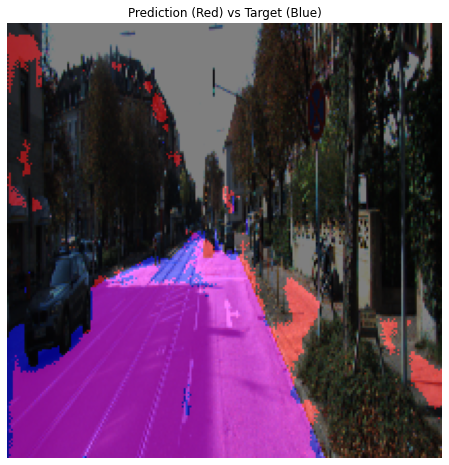

In [62]:
# 1. 원본 이미지 준비
resized = resized_img.astype(np.float32) / 255.0  # Normalize (0~1 범위)

# 2. RGB 마스크 생성
overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)

# 예측 영역 (빨간색)
overlay[..., 0] = prediction * 1.0  # Red 채널 활성화 (1이면 빨간색)

# 실제 영역 (파란색)
overlay[..., 2] = target * 1.0  # Blue 채널 활성화 (1이면 파란색)

# 겹치는 영역 (빨간 + 파랑 = 보라색)
# 이미 겹치는 부분은 색이 섞이므로 따로 추가할 필요 없음

# 3. 투명도 적용 (alpha blending)
alpha = 0.5
blended_img = (1 - alpha) * resized + alpha * overlay

# 4. 결과 시각화
plt.figure(figsize=(8, 8))
plt.imshow(blended_img)
plt.axis("off")
plt.title("Prediction (Red) vs Target (Blue)")
plt.show()

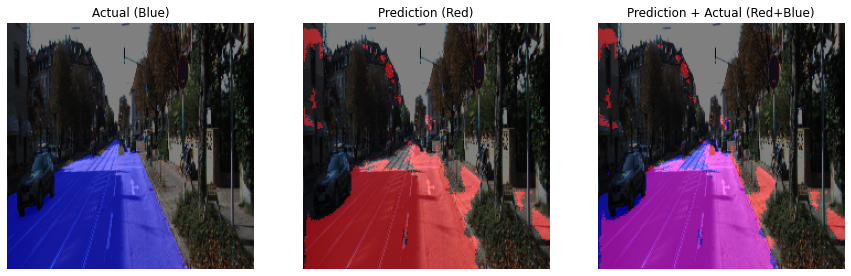

IoU : 0.798723


0.7987231413468799

In [63]:
import numpy as np
import matplotlib.pyplot as plt

# 1. 원본 이미지 정규화
resized = resized_img.astype(np.float32) / 255.0  # 0~1 범위로 변환

# 2. RGB 마스크 생성 (target, prediction 각각 적용)
target_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
prediction_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
combined_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)

# 실제 값 마스크 (파란색)
target_overlay[..., 2] = target * 1.0  # Blue 채널 활성화

# 예측 값 마스크 (빨간색)
prediction_overlay[..., 0] = prediction * 1.0  # Red 채널 활성화

# 합친 마스크 (빨강 + 파랑 = 보라색)
combined_overlay[..., 0] = prediction * 1.0  # 예측 (Red)
combined_overlay[..., 2] = target * 1.0  # 실제 (Blue)

# 3. 투명도(alpha blending) 적용
alpha = 0.5
target_img = (1 - alpha) * resized + alpha * target_overlay
prediction_img = (1 - alpha) * resized + alpha * prediction_overlay
combined_img = (1 - alpha) * resized + alpha * combined_overlay

# 4. 결과 시각화 (1행 3열)
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# 실제 값 (파란색)
axes[0].imshow(target_img)
axes[0].set_title("Actual (Blue)")
axes[0].axis("off")

# 예측 값 (빨간색)
axes[1].imshow(prediction_img)
axes[1].set_title("Prediction (Red)")
axes[1].axis("off")

# 합친 결과 (보라색)
axes[2].imshow(combined_img)
axes[2].set_title("Prediction + Actual (Red+Blue)")
axes[2].axis("off")

# 출력
plt.show()
calculate_iou_score(target, prediction)

In [64]:
# 인도를 도로로 잘못 예측하는 부분이 존재한다.

In [65]:
# 더욱 다양한 샘플에 대해 정성, 정량 평가해보자.
# 데이터 로더 부분을 보면 train과 validation 만 구분 하고 있다.
# 따라서 Test set을 분리할 수 있도록 하자.

In [66]:
def evauate(origin_img, output, prediction, target):
    # 원본 이미지 Resize
    resized_img = A.Resize(224, 224)(image=origin_img)["image"]
    
    # 1. 원본 이미지 정규화
    resized = resized_img.astype(np.float32) / 255.0  # 0~1 범위로 변환

    # 2. RGB 마스크 생성 (target, prediction 각각 적용)
    target_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
    prediction_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
    combined_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)

    # 실제 값 마스크 (파란색)
    target_overlay[..., 2] = target * 1.0  # Blue 채널 활성화

    # 예측 값 마스크 (빨간색)
    prediction_overlay[..., 0] = prediction * 1.0  # Red 채널 활성화

    # 합친 마스크 (빨강 + 파랑 = 보라색)
    combined_overlay[..., 0] = prediction * 1.0  # 예측 (Red)
    combined_overlay[..., 2] = target * 1.0  # 실제 (Blue)

    # 3. 투명도(alpha blending) 적용
    alpha = 0.5
    target_img = (1 - alpha) * resized + alpha * target_overlay
    prediction_img = (1 - alpha) * resized + alpha * prediction_overlay
    combined_img = (1 - alpha) * resized + alpha * combined_overlay

    # 4. 결과 시각화 (1행 3열)
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # 실제 값 (파란색)
    axes[0].imshow(target_img)
    axes[0].set_title("Actual (Blue)")
    axes[0].axis("off")

    # 예측 값 (빨간색)
    axes[1].imshow(prediction_img)
    axes[1].set_title("Prediction (Red)")
    axes[1].axis("off")

    # 합친 결과 (보라색)
    axes[2].imshow(combined_img)
    axes[2].set_title("Prediction + Actual (Red+Blue)")
    axes[2].axis("off")

    # 출력
    plt.show()
    calculate_iou_score(target, prediction)
    
    return

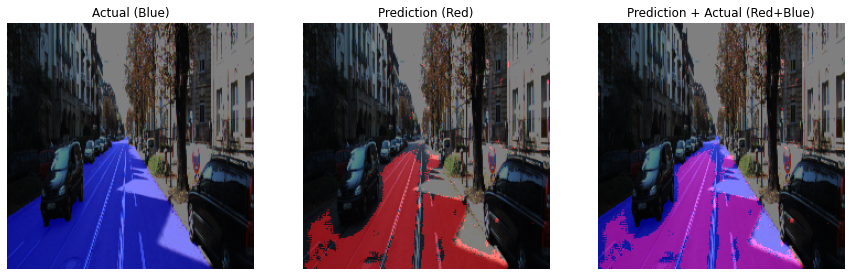

IoU : 0.677340


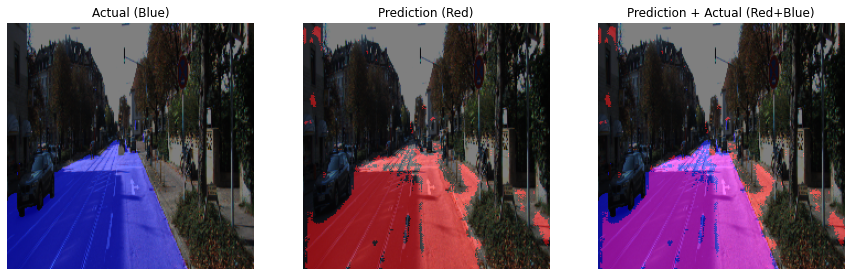

IoU : 0.798655


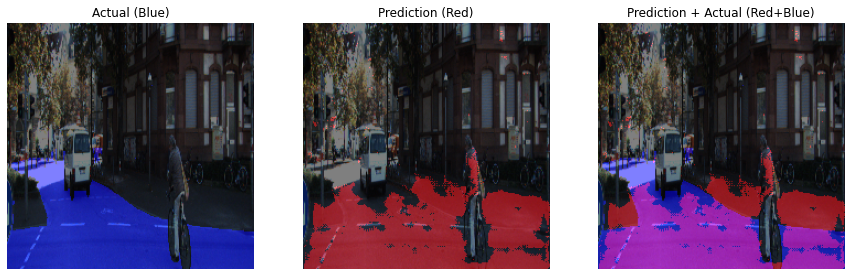

IoU : 0.577109


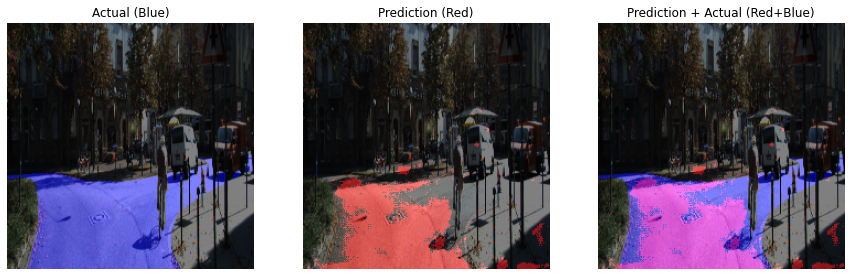

IoU : 0.585300


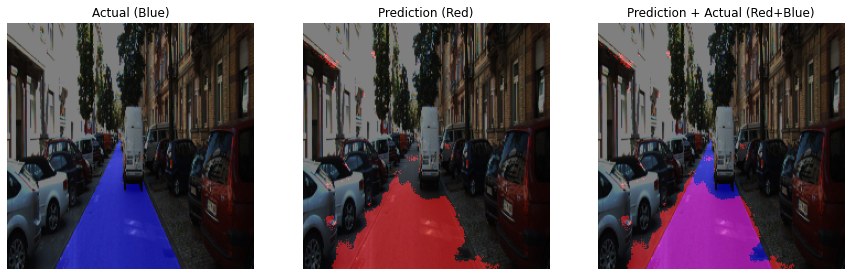

IoU : 0.718008


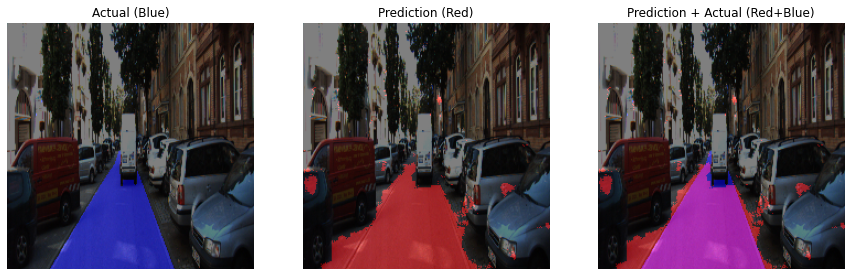

IoU : 0.747635


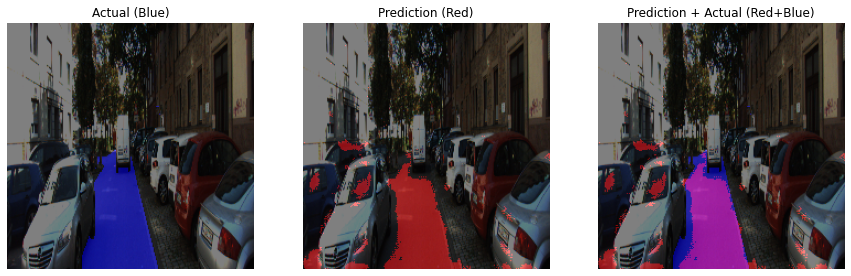

IoU : 0.627234


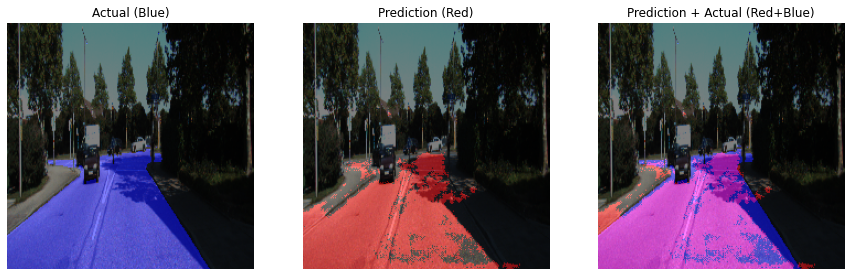

IoU : 0.751669


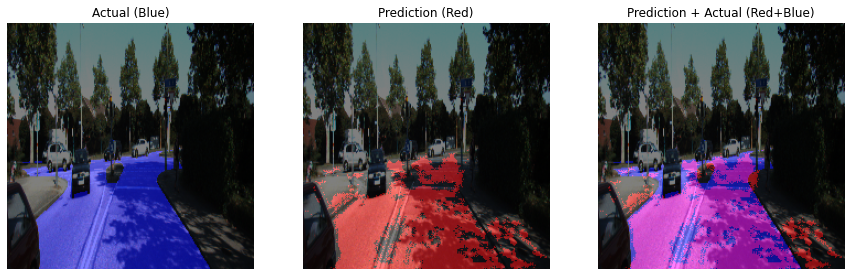

IoU : 0.694740


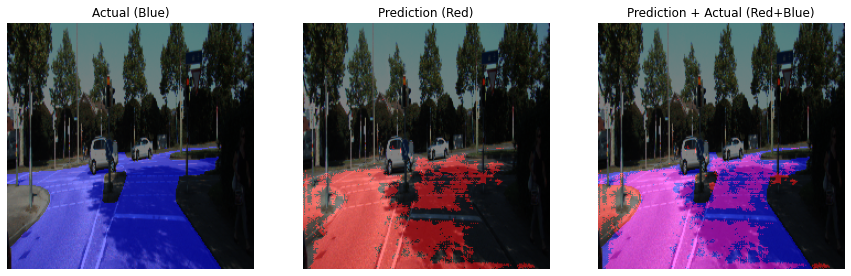

IoU : 0.646560


In [68]:
for i in range(10):
    origin_img, output, prediction, target = get_output(
         model_unet_plus_plus, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    
    evauate(origin_img, output, prediction, target)

In [69]:
# 도로를 인식하는 Task를 생각해보면 도로를 인식하는 것도 중요하지만, 도로가 아닌 것을 인식하는 것 또한 매우 중요하다.
# 정성적으로 10개 이미지를 평가해본다면, 도로가 아닌 사람, 자전거탄 사람, 인도 등을 도로로 인식하는 경우가 빈번하게 발생한다.
# 매우 크리티컬한 평가 결과이다.

# IOU 또한 적절한 메트릭이 아닌 것 같다.
# 잘못 인식하는 것에 대한 추가적인 패널티를 줄 수 있는 메트릭이 필요하다. (필요하다면 학습에 사용할 Loss도?)

# Metric 설정 후 U-Net, U-Net++ 학습
**콜백**
- 10에포크마다 가중치 저장
- 얼리스탑핑 20 patiance
- 베스트 모델 저장
- current 모델 저장

In [8]:
# 계산 메트릭으로 IOU, Accuracy, FN으로 했다.
# FN은 도로가 아님에도 도로로 예측한 경우. -> 크리티컬 하기 때문에 선정했다.

# IoU 계산 함수
def iou_metric(y_true, y_pred):
    """
    IoU (Intersection over Union) 계산
    - y_true: 실제 값 (Binary Mask, 0 또는 1)
    - y_pred: 예측 값 (0~1 범위, Sigmoid 적용)
    """
    y_pred = tf.cast(y_pred > 0.5, tf.float32)  # 0.5 기준으로 이진화
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))  # 안정성을 위해 작은 값 추가
    return iou


# Accuracy 계산 함수
def accuracy_metric(y_true, y_pred):
    """
    Accuracy (정확도) 계산
    - y_true와 y_pred에서 일치하는 픽셀 수 / 전체 픽셀 수
    """
    y_pred = tf.cast(y_pred > 0.5, tf.float32)  # 0.5 기준으로 이진화
    correct_pixels = tf.reduce_sum(tf.cast(y_true == y_pred, tf.float32), axis=[1,2])
    total_pixels = tf.cast(tf.size(y_true), tf.float32) / tf.cast(tf.shape(y_true)[0], tf.float32)  # 배치 고려

    accuracy = tf.reduce_mean(correct_pixels / total_pixels)
    return accuracy


# False Positive (FP) 계산 함수
def false_positive_metric(y_true, y_pred):
    """
    False Positive (거짓 양성 비율) 계산
    - 실제는 0인데, 예측이 1인 경우의 비율
    """
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    false_positive = tf.reduce_sum(tf.cast((y_pred == 1) & (y_true == 0), tf.float32), axis=[1,2])
    total_negative = tf.reduce_sum(tf.cast(y_true == 0, tf.float32), axis=[1,2])

    fp_rate = tf.reduce_mean(false_positive / (total_negative + 1e-10))  # 분모 0 방지
    return fp_rate

In [9]:
# 데이터셋 train, val, test 분리
# tf.keras.utils.Sequence를 상속받은 generator 형태로 데이터를 구성
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               is_test=False,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.is_test = is_test
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]
    
    if self.is_test:
        test_set = data[-30:]
        return test_set
    
    elif self.is_train:
        train_set = data[:-60]
        return train_set
    
    val_set = data[-60:-30]
    return val_set
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [10]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
    is_train=True
)

val_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_test=True
)

In [11]:
len(train_generator), len(val_generator), len(test_generator)

(9, 2, 2)

In [13]:
# callback 설정
from tensorflow.keras.callbacks import CSVLogger, ModelCheckpoint, EarlyStopping, Callback

# 현재 모델을 에폭마다 저장 (save_best_only=False)
checkpoint_current = ModelCheckpoint(
    filepath="./current_model_Unet.h5",       # 저장 파일명 (원하는 경로와 파일명으로 변경)
    save_weights_only=True,            # 전체 모델 저장
    save_freq='epoch',                  # 매 에폭마다 저장
    verbose=1
)

# 베스트 모델 저장 (val_loss 기준)
checkpoint_best = ModelCheckpoint(
    filepath="./best_model_Unet.h5",           # 저장 파일명 (원하는 경로와 파일명으로 변경)
    monitor='val_loss',                 # 모니터링할 metric (예: val_loss)
    save_best_only=True,                # 베스트 모델만 저장
    save_weights_only=True,            # 전체 모델 저장
    verbose=1
)

class SaveWeightsEveryNEpochs(Callback):
    def __init__(self, model, save_path, n=10):
        super(SaveWeightsEveryNEpochs, self).__init__()
        self.model = model
        self.save_path = save_path
        self.n = n

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.n == 0:  # 10 에폭마다 저장
            file_path = self.save_path.format(epoch=epoch + 1)
            self.model.save_weights(file_path)
            print(f"\n🔹 Weights saved at epoch {epoch + 1}: {file_path}")

# 10 에폭마다 모델 웨이트 저장 설정
save_weights_every_10_epochs = SaveWeightsEveryNEpochs(
    model=model, 
    save_path="./weights_Unet_epoch_{epoch}.h5", 
    n=10
)

# 얼리스탑핑 (patience=20, 모니터는 val_loss)
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=20,
    verbose=1,
    restore_best_weights=True         # 학습 종료 후 베스트 가중치로 복원
)

# CSVLogger 콜백: 매 에폭의 loss와 metric을 기록
csv_logger = CSVLogger('./training_log.csv', append=True, separator=',')

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger, save_weights_every_10_epochs]

# iou metric
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

In [14]:
# 모델 학습
model = build_model()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric, accuracy_metric, false_positive_metric])
history = model.fit(
    train_generator,
    validation_data=val_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

Epoch 1/200
9/9 [==============================] - 46s 863ms/step - loss: 0.6815 - iou_metric: 0.1264 - accuracy_metric: 0.6696 - false_positive_metric: 0.2107 - val_loss: 0.6463 - val_iou_metric: 0.0625 - val_accuracy_metric: 0.8055 - val_false_positive_metric: 0.0000e+00

Epoch 00001: saving model to ./current_model_Unet.h5

Epoch 00001: val_loss improved from inf to 0.64625, saving model to ./best_model_Unet.h5
Epoch 2/200
9/9 [==============================] - 7s 722ms/step - loss: 0.6226 - iou_metric: 0.0764 - accuracy_metric: 0.7752 - false_positive_metric: 0.0000e+00 - val_loss: 0.5606 - val_iou_metric: 0.0625 - val_accuracy_metric: 0.8055 - val_false_positive_metric: 0.0000e+00

Epoch 00002: saving model to ./current_model_Unet.h5

Epoch 00002: val_loss improved from 0.64625 to 0.56065, saving model to ./best_model_Unet.h5
Epoch 3/200
9/9 [==============================] - 7s 708ms/step - loss: 0.5857 - iou_metric: 0.0972 - accuracy_metric: 0.7760 - false_positive_metric: 0.000


🔹 Weights saved at epoch 40: ./weights_Unet_epoch_40.h5
Epoch 41/200
9/9 [==============================] - 7s 730ms/step - loss: 0.1249 - iou_metric: 0.7827 - accuracy_metric: 0.9552 - false_positive_metric: 0.0300 - val_loss: 0.1850 - val_iou_metric: 0.6910 - val_accuracy_metric: 0.9277 - val_false_positive_metric: 0.0468

Epoch 00041: saving model to ./current_model_Unet.h5

Epoch 00041: val_loss did not improve from 0.17495
Epoch 42/200
9/9 [==============================] - 7s 734ms/step - loss: 0.1369 - iou_metric: 0.7299 - accuracy_metric: 0.9472 - false_positive_metric: 0.0301 - val_loss: 0.1844 - val_iou_metric: 0.6268 - val_accuracy_metric: 0.9227 - val_false_positive_metric: 0.0624

Epoch 00042: saving model to ./current_model_Unet.h5

Epoch 00042: val_loss did not improve from 0.17495
Epoch 43/200
9/9 [==============================] - 7s 736ms/step - loss: 0.1466 - iou_metric: 0.7279 - accuracy_metric: 0.9444 - false_positive_metric: 0.0282 - val_loss: 0.1826 - val_iou_me

9/9 [==============================] - 7s 752ms/step - loss: 0.1269 - iou_metric: 0.7429 - accuracy_metric: 0.9526 - false_positive_metric: 0.0365 - val_loss: 0.1996 - val_iou_metric: 0.6810 - val_accuracy_metric: 0.9283 - val_false_positive_metric: 0.0392

Epoch 00062: saving model to ./current_model_Unet.h5

Epoch 00062: val_loss did not improve from 0.16602
Epoch 63/200
9/9 [==============================] - 7s 739ms/step - loss: 0.1169 - iou_metric: 0.7434 - accuracy_metric: 0.9551 - false_positive_metric: 0.0282 - val_loss: 0.1828 - val_iou_metric: 0.7002 - val_accuracy_metric: 0.9273 - val_false_positive_metric: 0.0560

Epoch 00063: saving model to ./current_model_Unet.h5

Epoch 00063: val_loss did not improve from 0.16602
Epoch 64/200
9/9 [==============================] - 7s 744ms/step - loss: 0.1075 - iou_metric: 0.7845 - accuracy_metric: 0.9569 - false_positive_metric: 0.0252 - val_loss: 0.1783 - val_iou_metric: 0.6883 - val_accuracy_metric: 0.9291 - val_false_positive_metric

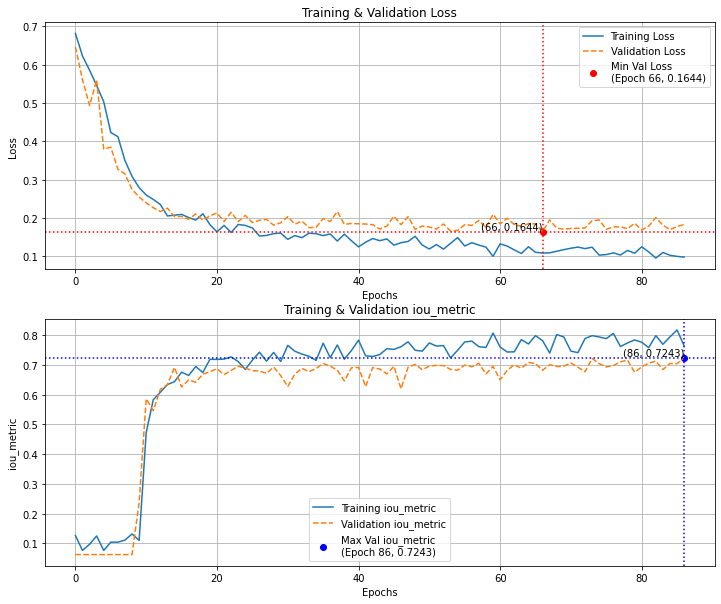

In [16]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요
loss_name = 'loss'
metric_name = 'iou_metric'
val_loss_name = 'val_' + loss_name
val_metric_name = 'val_' + metric_name

# ✅ 손실 및 정확도 값 가져오기
train_loss = history.history[loss_name]
val_loss = history.history[val_loss_name]
train_acc = history.history[metric_name]
val_acc = history.history[val_metric_name]

# ✅ Validation 기준 최하점 (Loss) & 최고점 (Accuracy) 찾기
min_val_loss_epoch = np.argmin(val_loss)  # 최소 validation loss의 epoch
min_val_loss = val_loss[min_val_loss_epoch]

max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

# ✅ 손실 (Loss) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss', linestyle='dashed')

# 최소 validation loss 지점 표시
plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss\n(Epoch {min_val_loss_epoch}, {min_val_loss:.4f})')
plt.text(min_val_loss_epoch, min_val_loss, f'({min_val_loss_epoch}, {min_val_loss:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_loss_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_loss, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid()

# ✅ 정확도 (Accuracy) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_acc, label=('Training ' + metric_name))
plt.plot(val_acc, label=('Validation ' + metric_name), linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val {metric_name}\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel(metric_name)
plt.title(f'Training & Validation {metric_name}')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()

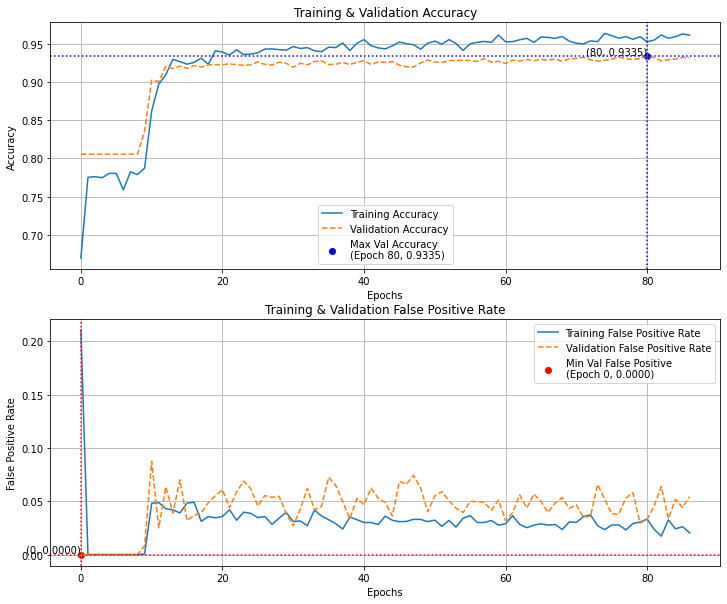

In [17]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요

# ✅ 손실 및 정확도 값 가져오기
accuracy_metric = 'accuracy_metric'
false_positive_metric = 'false_positive_metric'

train_acc = history.history[accuracy_metric]
val_acc = history.history['val_' + accuracy_metric]
train_fp = history.history[false_positive_metric]
val_fp = history.history['val_' + false_positive_metric]

# ✅ 최고점 (Accuracy) & 최저점 (False Positive) 찾기
max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

min_val_fp_epoch = np.argmin(val_fp)  # 최소 false positive의 epoch
min_val_fp = val_fp[min_val_fp_epoch]

# ✅ 정확도 (Accuracy) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy', linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val Accuracy\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Training & Validation Accuracy')
plt.legend()
plt.grid()

# ✅ False Positive (False Positive Rate) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_fp, label='Training False Positive Rate')
plt.plot(val_fp, label='Validation False Positive Rate', linestyle='dashed')

# 최소 false positive 지점 표시
plt.scatter(min_val_fp_epoch, min_val_fp, color='red', label=f'Min Val False Positive\n(Epoch {min_val_fp_epoch}, {min_val_fp:.4f})')
plt.text(min_val_fp_epoch, min_val_fp, f'({min_val_fp_epoch}, {min_val_fp:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_fp_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_fp, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('False Positive Rate')
plt.title('Training & Validation False Positive Rate')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()


In [29]:
# U-net++

# callback 설정
from tensorflow.keras.callbacks import CSVLogger, ModelCheckpoint, EarlyStopping, Callback

# 현재 모델을 에폭마다 저장 (save_best_only=False)
checkpoint_current = ModelCheckpoint(
    filepath="./current_model_unet_plus_plus.h5",       # 저장 파일명 (원하는 경로와 파일명으로 변경)
    save_weights_only=True,            # 전체 모델 저장
    save_freq='epoch',                  # 매 에폭마다 저장
    verbose=1
)

# 베스트 모델 저장 (val_loss 기준)
checkpoint_best = ModelCheckpoint(
    filepath="./best_model_unet_plus_plus.h5",           # 저장 파일명 (원하는 경로와 파일명으로 변경)
    monitor='val_loss',                 # 모니터링할 metric (예: val_loss)
    save_best_only=True,                # 베스트 모델만 저장
    save_weights_only=True,            # 전체 모델 저장
    verbose=1
)

class SaveWeightsEveryNEpochs(Callback):
    def __init__(self, model, save_path, n=10):
        super(SaveWeightsEveryNEpochs, self).__init__()
        self.model = model
        self.save_path = save_path
        self.n = n

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.n == 0:  # 10 에폭마다 저장
            file_path = self.save_path.format(epoch=epoch + 1)
            self.model.save_weights(file_path)
            print(f"\n🔹 Weights saved at epoch {epoch + 1}: {file_path}")

# 10 에폭마다 모델 웨이트 저장 설정
save_weights_every_10_epochs = SaveWeightsEveryNEpochs(
    model=model_unet_plus_plus, 
    save_path="./weights_unet_plus_plus_epoch_{epoch}.h5", 
    n=10
)

# 얼리스탑핑 (patience=20, 모니터는 val_loss)
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=20,
    verbose=1,
    restore_best_weights=True         # 학습 종료 후 베스트 가중치로 복원
)

# CSVLogger 콜백: 매 에폭의 loss와 metric을 기록
csv_logger = CSVLogger('./training_log.csv', append=True, separator=',')

callbacks = [checkpoint_current, checkpoint_best, early_stopping, csv_logger, save_weights_every_10_epochs]

# iou metric
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

In [30]:
# 데이터셋 train, val, test 분리
# tf.keras.utils.Sequence를 상속받은 generator 형태로 데이터를 구성
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=8,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               is_test=False,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.is_test = is_test
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]
    
    if self.is_test:
        test_set = data[-30:]
        return test_set
    
    elif self.is_train:
        train_set = data[:-60]
        return train_set
    
    val_set = data[-60:-30]
    return val_set
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [31]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
    is_train=True
)

val_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_test=True
)

In [32]:
len(train_generator), len(val_generator), len(test_generator)

(18, 4, 4)

In [33]:
# 모델 학습
model_unet_plus_plus.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric])
history = model_unet_plus_plus.fit(
    train_generator,
    validation_data=val_generator,
    steps_per_epoch=len(train_generator),
    epochs=200,
    callbacks=callbacks
 )

Epoch 1/200
18/18 [==============================] - 24s 1s/step - loss: 1.2725 - output1_loss: 0.4110 - output2_loss: 0.3188 - output3_loss: 0.2832 - output4_loss: 0.2595 - output1_iou_metric: 0.5115 - output2_iou_metric: 0.5969 - output3_iou_metric: 0.6027 - output4_iou_metric: 0.6582 - val_loss: 2.4228 - val_output1_loss: 0.8101 - val_output2_loss: 0.5616 - val_output3_loss: 0.5330 - val_output4_loss: 0.5181 - val_output1_iou_metric: 0.1933 - val_output2_iou_metric: 0.1136 - val_output3_iou_metric: 0.0666 - val_output4_iou_metric: 0.0625

Epoch 00001: saving model to ./current_model_unet_plus_plus.h5

Epoch 00001: val_loss improved from inf to 2.42281, saving model to ./best_model_unet_plus_plus.h5
Epoch 2/200
18/18 [==============================] - 20s 1s/step - loss: 1.2468 - output1_loss: 0.3953 - output2_loss: 0.3111 - output3_loss: 0.2807 - output4_loss: 0.2597 - output1_iou_metric: 0.5389 - output2_iou_metric: 0.5929 - output3_iou_metric: 0.6074 - output4_iou_metric: 0.6231 -

18/18 [==============================] - 20s 1s/step - loss: 0.6690 - output1_loss: 0.2267 - output2_loss: 0.1683 - output3_loss: 0.1447 - output4_loss: 0.1293 - output1_iou_metric: 0.6899 - output2_iou_metric: 0.7601 - output3_iou_metric: 0.7801 - output4_iou_metric: 0.7892 - val_loss: 1.3347 - val_output1_loss: 0.3696 - val_output2_loss: 0.3786 - val_output3_loss: 0.3256 - val_output4_loss: 0.2609 - val_output1_iou_metric: 0.2334 - val_output2_iou_metric: 0.1206 - val_output3_iou_metric: 0.2566 - val_output4_iou_metric: 0.4347

Epoch 00029: saving model to ./current_model_unet_plus_plus.h5

Epoch 00029: val_loss did not improve from 1.07792
Epoch 30/200
18/18 [==============================] - 20s 1s/step - loss: 0.7121 - output1_loss: 0.2332 - output2_loss: 0.1817 - output3_loss: 0.1577 - output4_loss: 0.1395 - output1_iou_metric: 0.6775 - output2_iou_metric: 0.7288 - output3_iou_metric: 0.7450 - output4_iou_metric: 0.7650 - val_loss: 1.5230 - val_output1_loss: 0.5443 - val_output2_


🔹 Weights saved at epoch 40: ./weights_unet_plus_plus_epoch_40.h5
Epoch 41/200
18/18 [==============================] - 20s 1s/step - loss: 0.5906 - output1_loss: 0.2094 - output2_loss: 0.1448 - output3_loss: 0.1239 - output4_loss: 0.1125 - output1_iou_metric: 0.6864 - output2_iou_metric: 0.7435 - output3_iou_metric: 0.7669 - output4_iou_metric: 0.7687 - val_loss: 0.8997 - val_output1_loss: 0.2582 - val_output2_loss: 0.2234 - val_output3_loss: 0.2119 - val_output4_loss: 0.2063 - val_output1_iou_metric: 0.6192 - val_output2_iou_metric: 0.5897 - val_output3_iou_metric: 0.6149 - val_output4_iou_metric: 0.6218

Epoch 00041: saving model to ./current_model_unet_plus_plus.h5

Epoch 00041: val_loss improved from 0.90625 to 0.89974, saving model to ./best_model_unet_plus_plus.h5
Epoch 42/200
18/18 [==============================] - 20s 1s/step - loss: 0.6899 - output1_loss: 0.2232 - output2_loss: 0.1674 - output3_loss: 0.1513 - output4_loss: 0.1480 - output1_iou_metric: 0.6919 - output2_iou_m

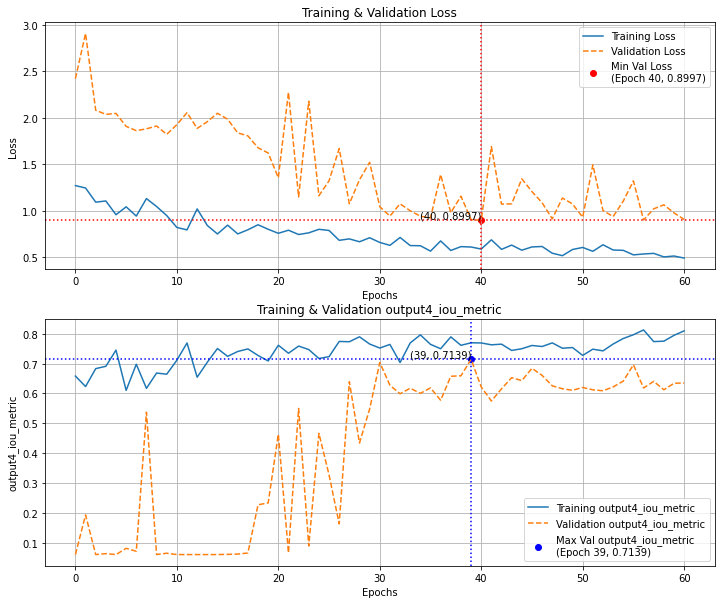

In [34]:
# ✅ 모델 훈련 후 history 객체 확인 필요
history = history  # 모델 훈련 후 다시 할당 필요
loss_name = 'loss'
metric_name = 'output4_iou_metric'
val_loss_name = 'val_' + loss_name
val_metric_name = 'val_' + metric_name

# ✅ 손실 및 정확도 값 가져오기
train_loss = history.history[loss_name]
val_loss = history.history[val_loss_name]
train_acc = history.history[metric_name]
val_acc = history.history[val_metric_name]

# ✅ Validation 기준 최하점 (Loss) & 최고점 (Accuracy) 찾기
min_val_loss_epoch = np.argmin(val_loss)  # 최소 validation loss의 epoch
min_val_loss = val_loss[min_val_loss_epoch]

max_val_acc_epoch = np.argmax(val_acc)  # 최대 validation accuracy의 epoch
max_val_acc = val_acc[max_val_acc_epoch]

# ✅ 손실 (Loss) 그래프
plt.figure(figsize=(12, 10))
plt.subplot(2, 1, 1)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss', linestyle='dashed')

# 최소 validation loss 지점 표시
plt.scatter(min_val_loss_epoch, min_val_loss, color='red', label=f'Min Val Loss\n(Epoch {min_val_loss_epoch}, {min_val_loss:.4f})')
plt.text(min_val_loss_epoch, min_val_loss, f'({min_val_loss_epoch}, {min_val_loss:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(min_val_loss_epoch, linestyle='dotted', color='red')
plt.axhline(min_val_loss, linestyle='dotted', color='red')

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training & Validation Loss')
plt.legend()
plt.grid()

# ✅ 정확도 (Accuracy) 그래프
plt.subplot(2, 1, 2)
plt.plot(train_acc, label=('Training ' + metric_name))
plt.plot(val_acc, label=('Validation ' + metric_name), linestyle='dashed')

# 최대 validation accuracy 지점 표시
plt.scatter(max_val_acc_epoch, max_val_acc, color='blue', label=f'Max Val {metric_name}\n(Epoch {max_val_acc_epoch}, {max_val_acc:.4f})')
plt.text(max_val_acc_epoch, max_val_acc, f'({max_val_acc_epoch}, {max_val_acc:.4f})', fontsize=10, verticalalignment='bottom', horizontalalignment='right')

# 점선 추가 (가로, 세로)
plt.axvline(max_val_acc_epoch, linestyle='dotted', color='blue')
plt.axhline(max_val_acc, linestyle='dotted', color='blue')

plt.xlabel('Epochs')
plt.ylabel(metric_name)
plt.title(f'Training & Validation {metric_name}')
plt.legend()
plt.grid()

# ✅ 그래프 출력
plt.show()

# U-Net, U-Net++ 베스트 모델로 평가하기(정성, 정량)

In [9]:
# 베스트 모델에 대해 정성, 정량 평가를 해보자.

In [17]:
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    """
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

# Accuracy 계산 함수
def accuracy_metric(y_true, y_pred):
    """
    Accuracy (정확도) 계산
    - y_true와 y_pred에서 일치하는 픽셀 수 / 전체 픽셀 수
    """
    y_pred = tf.cast(y_pred > 0.5, tf.float32)  # 0.5 기준으로 이진화
    correct_pixels = tf.reduce_sum(tf.cast(y_true == y_pred, tf.float32), axis=[1,2])
    total_pixels = tf.cast(tf.size(y_true), tf.float32) / tf.cast(tf.shape(y_true)[0], tf.float32)  # 배치 고려

    accuracy = tf.reduce_mean(correct_pixels / total_pixels)
    return accuracy


# False Positive (FP) 계산 함수
def false_positive_metric(y_true, y_pred):
    """
    False Positive (거짓 양성 비율) 계산
    - 실제는 0인데, 예측이 1인 경우의 비율
    """
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    false_positive = tf.reduce_sum(tf.cast((y_pred == 1) & (y_true == 0), tf.float32), axis=[1,2])
    total_negative = tf.reduce_sum(tf.cast(y_true == 0, tf.float32), axis=[1,2])

    fp_rate = tf.reduce_mean(false_positive / (total_negative + 1e-10))  # 분모 0 방지
    return fp_rate

In [153]:
# U-Net 구현
from tensorflow.keras import layers, Model

def conv_block(x, filters):
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    return x

def crop_and_concat(encoder_layer, decoder_layer):
    """
    encoder_layer의 feature map을 decoder_layer와 concat하기 위해
    encoder_layer를 적절하게 crop합니다.
    """
    # static shape 정보를 이용 (입력 shape가 고정된 경우 사용 가능)
    encoder_shape = tf.keras.backend.int_shape(encoder_layer)
    decoder_shape = tf.keras.backend.int_shape(decoder_layer)
    
    # encoder_shape, decoder_shape는 (batch, height, width, channels) 형태입니다.
    crop_height = encoder_shape[1] - decoder_shape[1]
    crop_width = encoder_shape[2] - decoder_shape[2]
    
    # crop이 대칭으로 이루어지도록 위/아래, 좌/우 cropping 값을 계산합니다.
    cropping = (
        (crop_height // 2, crop_height - crop_height // 2),
        (crop_width // 2, crop_width - crop_width // 2)
    )
    
    # Cropping2D는 cropping 인자로 ((top, bottom), (left, right)) 튜플을 받습니다.
    cropped_encoder = layers.Cropping2D(cropping=cropping)(encoder_layer)
    return layers.Concatenate()([cropped_encoder, decoder_layer])

def build_model(input_shape=(224, 224, 3)):
    model = None
    # TODO: input_shape에 따라 U-Net을 만들어주세요
    # 이때 model은 fully convolutional해야 합니다.
    inputs = layers.Input(input_shape)

    # Encoder (Contracting Path)
    c1 = conv_block(inputs, 64)
    p1 = layers.MaxPooling2D((2, 2), strides=2)(c1)

    c2 = conv_block(p1, 128)
    p2 = layers.MaxPooling2D((2, 2), strides=2)(c2)

    c3 = conv_block(p2, 256)
    p3 = layers.MaxPooling2D((2, 2), strides=2)(c3)

    c4 = conv_block(p3, 512)
    p4 = layers.MaxPooling2D((2, 2), strides=2)(c4)

    # Bottleneck
    c5 = conv_block(p4, 1024)

    # Decoder (Expanding Path)
    u6 = layers.Conv2DTranspose(512, (2, 2), strides=2, padding="same")(c5)
    u6 = crop_and_concat(c4, u6)
    c6 = conv_block(u6, 512)

    u7 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(c6)
    u7 = crop_and_concat(c3, u7)
    c7 = conv_block(u7, 256)

    u8 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(c7)
    u8 = crop_and_concat(c2, u8)
    c8 = conv_block(u8, 128)

    u9 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(c8)
    u9 = crop_and_concat(c1, u9)
    c9 = conv_block(u9, 64)

    # Output Layer
    outputs = layers.Conv2D(1, (1, 1), activation="sigmoid")(c9)  # 2 클래스 segmentation map

    model = Model(inputs, outputs, name="U-Net")
    return model

# 훈련된 모델 불러오기
model = build_model()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric, accuracy_metric, false_positive_metric])
model.load_weights('./best_model_Unet.h5')

In [25]:
# U-net++(neseted_U-net) 구현하기
from tensorflow.keras import layers, Model
import tensorflow as tf

def conv_block(x, filters):
    """기본 컨볼루션 블록"""
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(filters, (3, 3), activation="relu", padding="same")(x)
    x = layers.BatchNormalization()(x)
    return x

def crop_and_concat(encoder_layer, decoder_layer):
    """
    encoder_layer의 feature map을 decoder_layer와 concat하기 위해
    encoder_layer를 적절하게 crop합니다.
    """
    # static shape 정보를 이용 (입력 shape가 고정된 경우 사용 가능)
    encoder_shape = tf.keras.backend.int_shape(encoder_layer)
    decoder_shape = tf.keras.backend.int_shape(decoder_layer)
    
    # encoder_shape, decoder_shape는 (batch, height, width, channels) 형태입니다.
    crop_height = encoder_shape[1] - decoder_shape[1]
    crop_width = encoder_shape[2] - decoder_shape[2]
    
    # crop이 대칭으로 이루어지도록 위/아래, 좌/우 cropping 값을 계산합니다.
    cropping = (
        (crop_height // 2, crop_height - crop_height // 2),
        (crop_width // 2, crop_width - crop_width // 2)
    )
    
    # Cropping2D는 cropping 인자로 ((top, bottom), (left, right)) 튜플을 받습니다.
    if crop_height > 0 or crop_width > 0:
        cropped_encoder = layers.Cropping2D(cropping=cropping)(encoder_layer)
    else:
        cropped_encoder = encoder_layer
    
    return layers.Concatenate()([cropped_encoder, decoder_layer])

def build_unet_plus_plus(input_shape=(224, 224, 3), num_classes=1, deep_supervision=True):
    """
    U-Net++ 모델을 구현합니다.
    
    Args:
        input_shape: 입력 이미지의 shape (height, width, channels)
        num_classes: 출력 클래스 수 (이진 분할의 경우 1)
        deep_supervision: 깊은 감독 사용 여부
        
    Returns:
        U-Net++ 모델
    """
    inputs = layers.Input(input_shape)
    
    # 노드 저장용 딕셔너리 (X_i_j 형식: i는 다운샘플링 레벨, j는 해당 레벨에서의 노드 인덱스)
    nodes = {}
    
    # Encoder (Contracting Path)
    nodes['X_0_0'] = conv_block(inputs, 64)
    p1 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_0_0'])
    
    nodes['X_1_0'] = conv_block(p1, 128)
    p2 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_1_0'])
    
    nodes['X_2_0'] = conv_block(p2, 256)
    p3 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_2_0'])
    
    nodes['X_3_0'] = conv_block(p3, 512)
    p4 = layers.MaxPooling2D((2, 2), strides=2)(nodes['X_3_0'])
    
    # Bottleneck
    nodes['X_4_0'] = conv_block(p4, 1024)
    
    # Decoder (Expanding Path with Nested Dense Skip Connections)
    
    # 레벨 3 (첫 번째 업샘플링 레벨)
    up1 = layers.Conv2DTranspose(512, (2, 2), strides=2, padding="same")(nodes['X_4_0'])
    nodes['X_3_1'] = conv_block(crop_and_concat(nodes['X_3_0'], up1), 512)
    
    # 레벨 2 (두 번째 업샘플링 레벨)
    up2_0 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(nodes['X_3_0'])
    nodes['X_2_1'] = conv_block(crop_and_concat(nodes['X_2_0'], up2_0), 256)
    
    up2_1 = layers.Conv2DTranspose(256, (2, 2), strides=2, padding="same")(nodes['X_3_1'])
    merged = crop_and_concat(nodes['X_2_0'], up2_1)
    merged = crop_and_concat(nodes['X_2_1'], merged)
    nodes['X_2_2'] = conv_block(merged, 256)
    
    # 레벨 1 (세 번째 업샘플링 레벨)
    up3_0 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_0'])
    nodes['X_1_1'] = conv_block(crop_and_concat(nodes['X_1_0'], up3_0), 128)
    
    up3_1 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_1'])
    merged = crop_and_concat(nodes['X_1_0'], up3_1)
    merged = crop_and_concat(nodes['X_1_1'], merged)
    nodes['X_1_2'] = conv_block(merged, 128)
    
    up3_2 = layers.Conv2DTranspose(128, (2, 2), strides=2, padding="same")(nodes['X_2_2'])
    merged = crop_and_concat(nodes['X_1_0'], up3_2)
    merged = crop_and_concat(nodes['X_1_1'], merged)
    merged = crop_and_concat(nodes['X_1_2'], merged)
    nodes['X_1_3'] = conv_block(merged, 128)
    
    # 레벨 0 (마지막 업샘플링 레벨)
    up4_0 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_0'])
    nodes['X_0_1'] = conv_block(crop_and_concat(nodes['X_0_0'], up4_0), 64)
    
    up4_1 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_1'])
    merged = crop_and_concat(nodes['X_0_0'], up4_1)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    nodes['X_0_2'] = conv_block(merged, 64)
    
    up4_2 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_2'])
    merged = crop_and_concat(nodes['X_0_0'], up4_2)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    merged = crop_and_concat(nodes['X_0_2'], merged)
    nodes['X_0_3'] = conv_block(merged, 64)
    
    up4_3 = layers.Conv2DTranspose(64, (2, 2), strides=2, padding="same")(nodes['X_1_3'])
    merged = crop_and_concat(nodes['X_0_0'], up4_3)
    merged = crop_and_concat(nodes['X_0_1'], merged)
    merged = crop_and_concat(nodes['X_0_2'], merged)
    merged = crop_and_concat(nodes['X_0_3'], merged)
    nodes['X_0_4'] = conv_block(merged, 64)
    
    # 출력 레이어 설정
    activation = 'sigmoid' if num_classes == 1 else 'softmax'
    
    # 깊은 감독(Deep Supervision) 구현
    if deep_supervision:
        output1 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output1')(nodes['X_0_1'])
        output2 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output2')(nodes['X_0_2'])
        output3 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output3')(nodes['X_0_3'])
        output4 = layers.Conv2D(num_classes, (1, 1), activation=activation, name='output4')(nodes['X_0_4'])
        
        model = Model(inputs=inputs, outputs=[output1, output2, output3, output4], name="unet_plus_plus")
    else:
        # 깊은 감독을 사용하지 않는 경우 최종 출력만 사용
        outputs = layers.Conv2D(num_classes, (1, 1), activation=activation)(nodes['X_0_4'])
        model = Model(inputs=inputs, outputs=outputs, name="unet_plus_plus")
        
    return model

# 모델 생성 및 요약 출력
model_unet_plus_plus = build_unet_plus_plus(input_shape=(224, 224, 3), num_classes=1, deep_supervision=True)

# 훈련된 모델 불러오기
model_unet_plus_plus.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric])
model_unet_plus_plus.load_weights('./best_model_unet_plus_plus.h5')

In [26]:
# 정량 평가
model.evaluate(test_generator, verbose=2)

2/2 - 29s - loss: 0.2090 - iou_metric: 0.7054 - accuracy_metric: 0.9168 - false_positive_metric: 0.0152


[0.20903724431991577,
 0.7054241895675659,
 0.9167567491531372,
 0.015167193487286568]

In [27]:
model_unet_plus_plus.evaluate(test_generator, verbose=2)

2/2 - 10s - loss: 1.0334 - output1_loss: 0.2989 - output2_loss: 0.2674 - output3_loss: 0.2353 - output4_loss: 0.2317 - output1_iou_metric: 0.6637 - output2_iou_metric: 0.6467 - output3_iou_metric: 0.6775 - output4_iou_metric: 0.6817


[1.0333504676818848,
 0.2988767623901367,
 0.2674047648906708,
 0.23532164096832275,
 0.23174729943275452,
 0.6636738181114197,
 0.6466992497444153,
 0.6774649620056152,
 0.681721568107605]

In [100]:
pred = model_unet_plus_plus.predict(test_generator)
np.array(pred).shape

(4, 32, 224, 224, 1)

In [101]:
np.array(pred)[-1:, :, :, :, :].shape

(1, 32, 224, 224, 1)

In [102]:
np.array(pred)[-1:, :, :, :, :].reshape(32, 224, 224).shape

(32, 224, 224)

In [103]:
pred = np.array(pred)[-1:, :, :, :, :].reshape(32, 224, 224)

In [104]:
test_generator

In [105]:
# test_generator에서 모든 라벨 데이터만 가져오기
test_inputs = []
test_labels = []

for i in range(len(test_generator)):
    inputs, labels = test_generator[i]  # 입력(X) 무시, 라벨(Y)만 저장
    test_inputs.append(inputs)
    test_labels.append(labels)

# NumPy 배열로 변환
test_inputs = np.concatenate(test_inputs, axis=0)
test_labels = np.concatenate(test_labels, axis=0)

test_inputs.shape, test_labels.shape

((32, 224, 224, 3), (32, 224, 224))

In [106]:
accuracy_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.9255577>

In [107]:
false_positive_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.01908692>

In [108]:
test_labels[-3:, :, :][0].sum()

10684.0

In [109]:
test_labels[-3:, :, :][1].sum()

0.0

In [110]:
test_labels[-3:, :, :][2].sum()

0.0

In [111]:
test_inputs[-3:, :, :, :][0].sum(), test_inputs[-3:, :, :, :][1].sum(), test_inputs[-3:, :, :, :][1].sum()

(56888.01960784314, 0.0, 0.0)

In [112]:
# 아... 배치단위로 반환하기 때문에 샘플개수는 30개 뿐인데 32개를 반환한다... 2개 샘플은 모두 0으로 되어 있다... 제기랄

In [113]:
# test_generator에서 모든 라벨 데이터만 가져오기
test_labels = []

for i in range(len(test_generator)):
    _, labels = test_generator[i]  # 입력(X) 무시, 라벨(Y)만 저장
    test_labels.append(labels)

# NumPy 배열로 변환
test_labels = np.concatenate(test_labels, axis=0)
test_labels[:30, :, :].shape

(30, 224, 224)

In [114]:
pred[:30, :, :].shape

(30, 224, 224)

In [115]:
test_labels = test_labels[:30, :, :]
pred = pred[:30, :, :]

In [118]:
def iou_metric(y_true, y_pred):
    """
    y_true: Ground truth (binary mask, 값이 0 또는 1)
    y_pred: 예측 결과 (0~1 범위, sigmoid를 사용한 경우)
    
    """
    # 데이터 타입을 float32로 통일
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    
    # 이미 (batch, height, width) 형태라면, axis=[1,2]로 수정
    y_pred = tf.cast(y_pred > 0.5, tf.float32)
    intersection = tf.reduce_sum(y_true * y_pred, axis=[1,2])
    union = tf.reduce_sum(y_true, axis=[1,2]) + tf.reduce_sum(y_pred, axis=[1,2]) - intersection

    iou = tf.reduce_mean((intersection + 1e-10) / (union + 1e-10))
    return iou

iou_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.7271697>

In [119]:
accuracy_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.9244147>

In [120]:
false_positive_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.016539494>

In [82]:
# 역시.. 값에 변동이 있다.

In [92]:
# 그러면 U-net도 올바르게 30개 샘플에 대해서 계산하고 있는지 확인이 필요하다.

In [121]:
pred = model.predict(test_generator)
np.array(pred).shape

(32, 224, 224, 1)

In [122]:
np.array(pred).reshape(32, 224, 224).shape

(32, 224, 224)

In [123]:
pred = np.array(pred).reshape(32, 224, 224)

In [124]:
test_labels = test_labels[:30, :, :]
pred = pred[:30, :, :]

In [125]:
iou_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.68578583>

In [126]:
accuracy_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.9112072>

In [127]:
false_positive_metric(y_true=test_labels, y_pred=pred)

<tf.Tensor: shape=(), dtype=float32, numpy=0.01617834>

In [ ]:
# 엄... 값이 차이가 난다...
# 결론적으로 샘플은 30개 뿐이지만 배치로 인해 32개를 반환하고 2개 샘플은 0으로 이루어져  evaluate 함수를 쓰면 안된다.

### 정량 평가 결과

In [43]:
# IOU  비교
# U-net : 0.68578583 / U-net++ : 0.6817

# Accuracy  비교
# U-net : 0.9112072 / U-net++ : 0.9244147

# false_positive_metric 비교
# U-net : 0.01617834 / U-net++ : 0.016539494

In [128]:
# IOU 측면에서는 비슷하다.
# Accuracy 측면에서는 U-net++ 이 살짝 높다.
# false_positive_metric 측면에서는 U-net이 살짝 높다. 224, 224 이므로 50,176개 픽셀이 존재하며, 
# 이중 절반이 False라고 가정하면 25,088 개 이다. 
# U-net(0.01617834)은 405개 픽셀정도, U-net++(0.016539494)은 414개 픽셀 정도 이다. 면적으로 치면 둘다 20*20 정도이다. 별차이 없다.

In [ ]:
# 이제 정성 평가를 해보자.

In [165]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = np.array(output).reshape(224, 224)
    output = (output>=0.5).astype(np.uint8)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
#     output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return origin_img, output, prediction, target
    else:
        return origin_img, output, prediction, _
    
def evauate(origin_img, output, prediction, target):
    # 원본 이미지 Resize
    resized_img = A.Resize(224, 224)(image=origin_img)["image"]
    
    # 1. 원본 이미지 정규화
    resized = resized_img.astype(np.float32) / 255.0  # 0~1 범위로 변환

    # 2. RGB 마스크 생성 (target, prediction 각각 적용)
    target_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
    prediction_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)
    combined_overlay = np.zeros_like(resized, dtype=np.float32)  # (224, 224, 3)

    # 실제 값 마스크 (파란색)
    target_overlay[..., 2] = target * 1.0  # Blue 채널 활성화

    # 예측 값 마스크 (빨간색)
    prediction_overlay[..., 0] = prediction * 1.0  # Red 채널 활성화

    # 합친 마스크 (빨강 + 파랑 = 보라색)
    combined_overlay[..., 0] = prediction * 1.0  # 예측 (Red)
    combined_overlay[..., 2] = target * 1.0  # 실제 (Blue)

    # 3. 투명도(alpha blending) 적용
    alpha = 0.5
    target_img = (1 - alpha) * resized + alpha * target_overlay
    prediction_img = (1 - alpha) * resized + alpha * prediction_overlay
    combined_img = (1 - alpha) * resized + alpha * combined_overlay

    # 4. 결과 시각화 (1행 3열)
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # 실제 값 (파란색)
    axes[0].imshow(target_img)
    axes[0].set_title("Actual (Blue)")
    axes[0].axis("off")

    # 예측 값 (빨간색)
    axes[1].imshow(prediction_img)
    axes[1].set_title("Prediction (Red)")
    axes[1].axis("off")

    # 합친 결과 (보라색)
    axes[2].imshow(combined_img)
    axes[2].set_title("Prediction + Actual (Red+Blue)")
    axes[2].axis("off")

    # 출력
    plt.show()
    calculate_iou_score(target, prediction)
    
    return

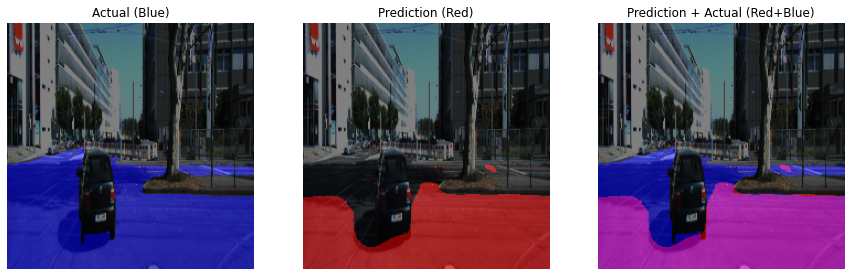

IoU : 0.722770


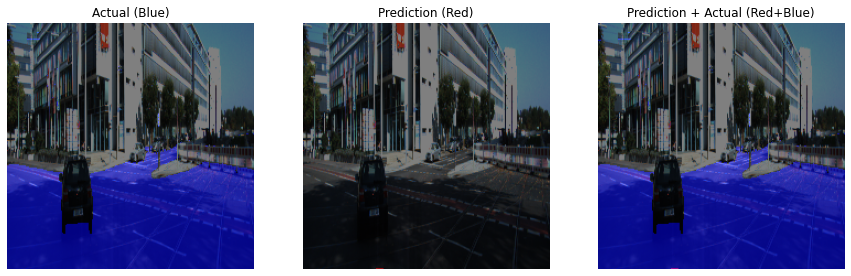

IoU : 0.000359


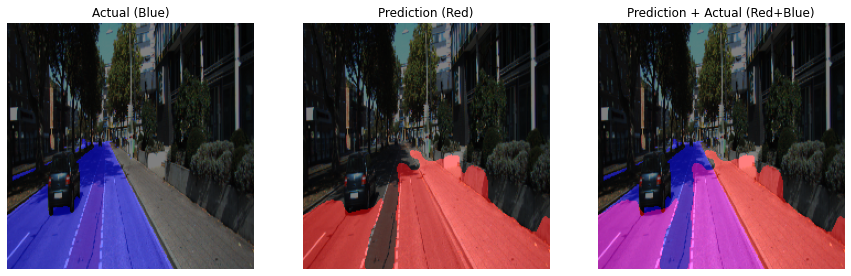

IoU : 0.435071


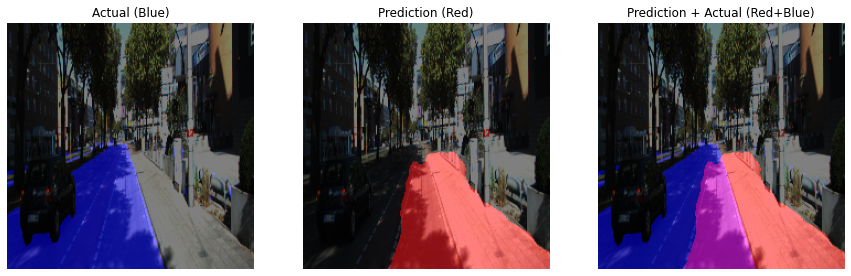

IoU : 0.255527


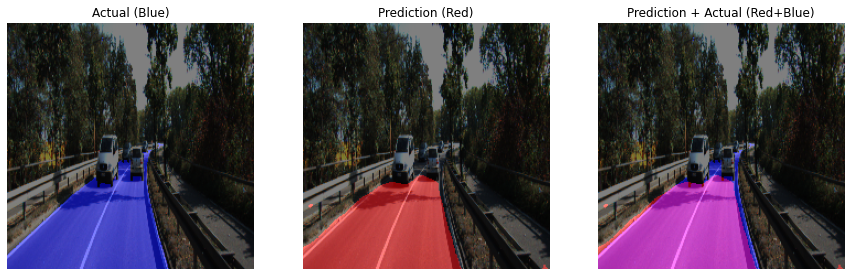

IoU : 0.899231


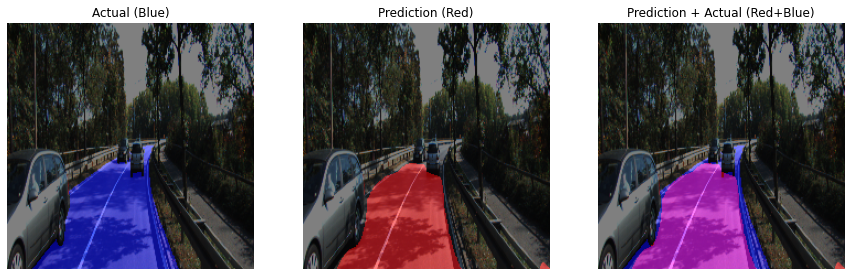

IoU : 0.841555


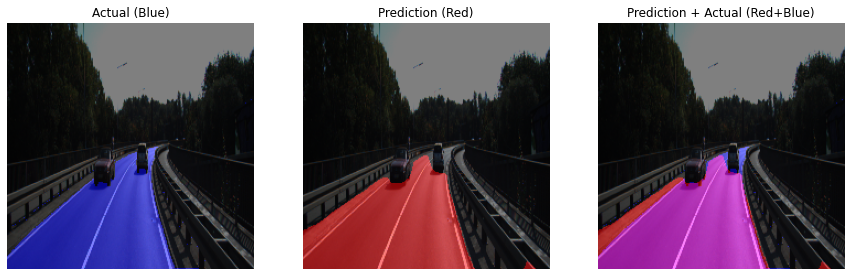

IoU : 0.874136


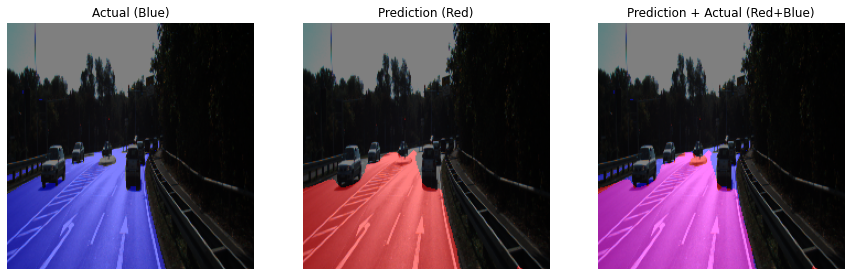

IoU : 0.938385


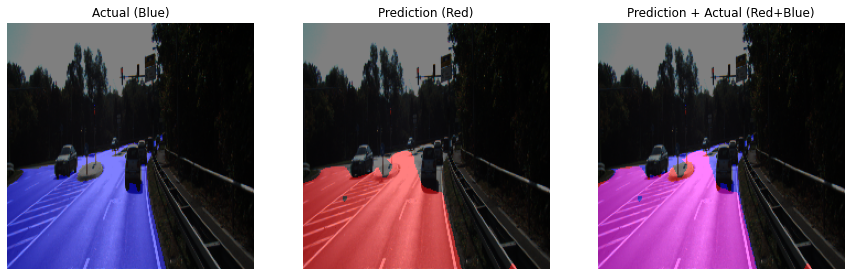

IoU : 0.926196


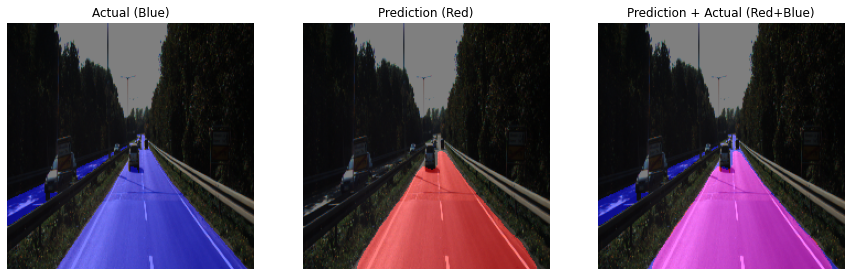

IoU : 0.877796


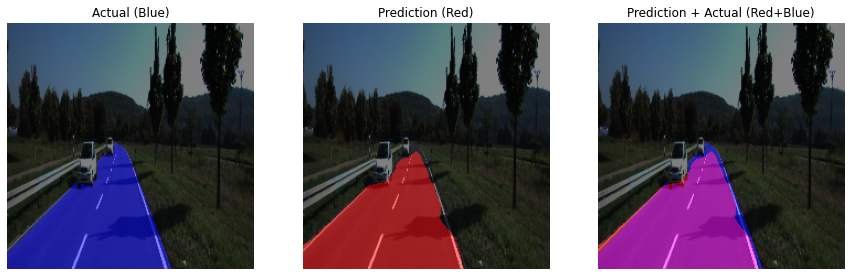

IoU : 0.920223


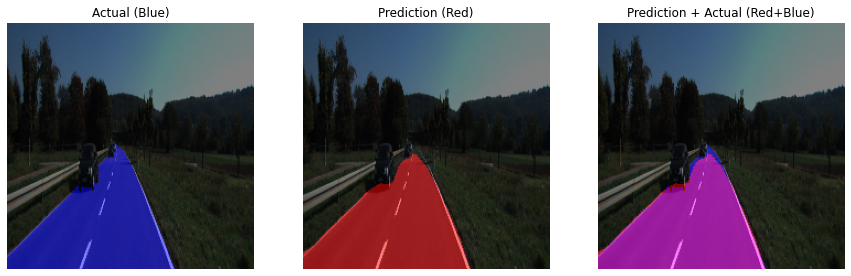

IoU : 0.964730


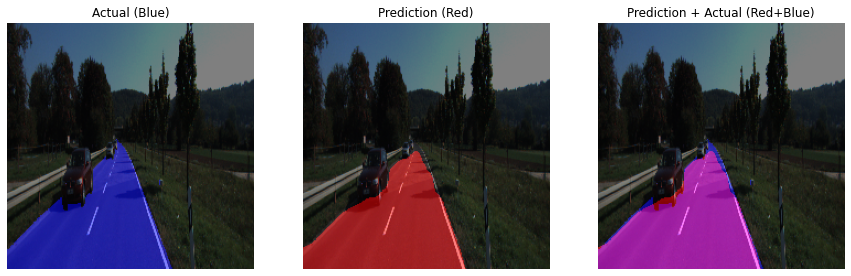

IoU : 0.941283


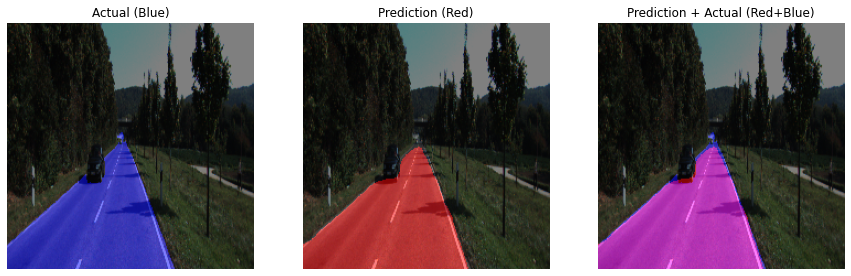

IoU : 0.958923


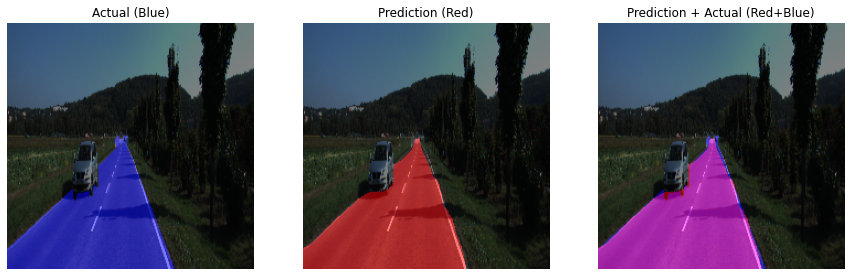

IoU : 0.963028


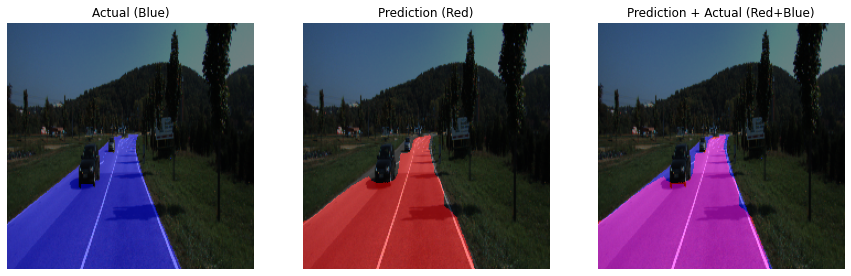

IoU : 0.953327


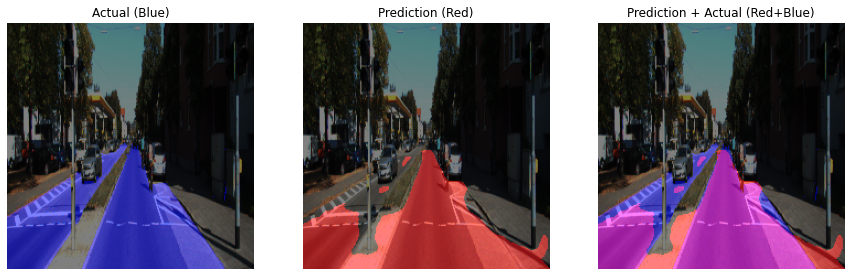

IoU : 0.710768


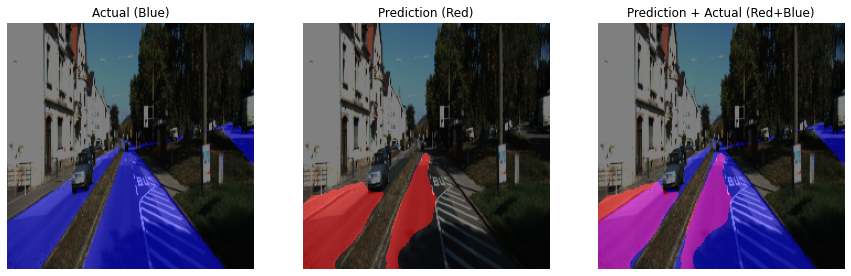

IoU : 0.417495


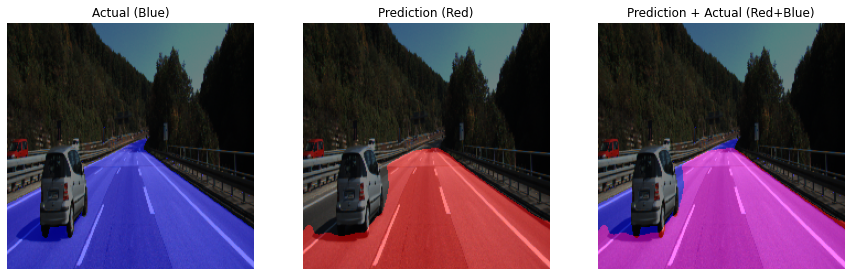

IoU : 0.900362


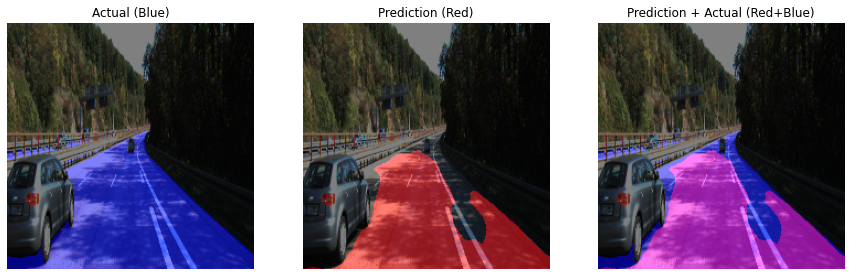

IoU : 0.770620


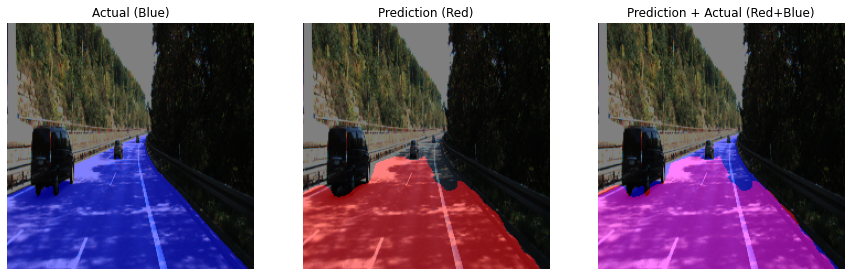

IoU : 0.913268


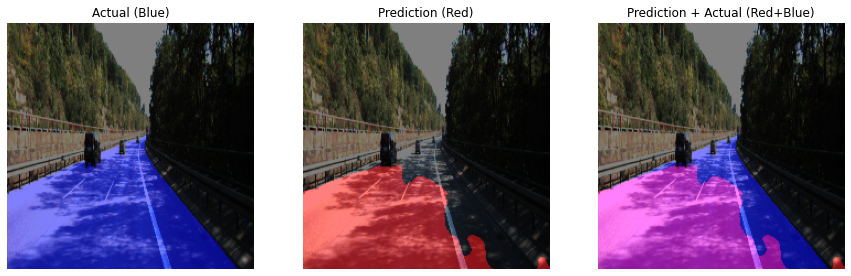

IoU : 0.723314


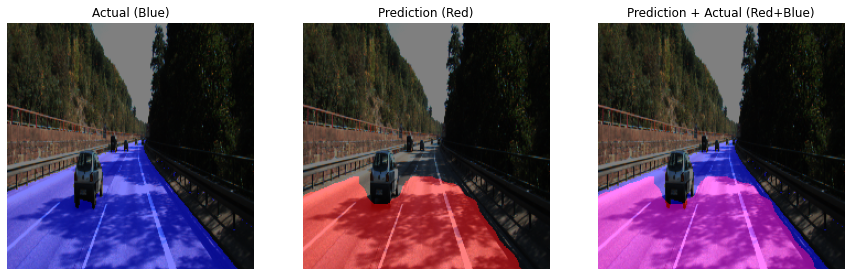

IoU : 0.840287


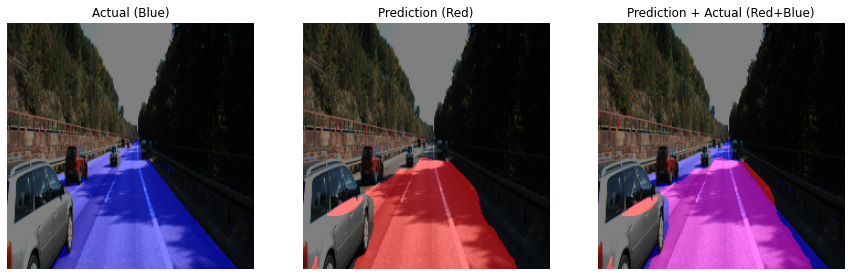

IoU : 0.831353


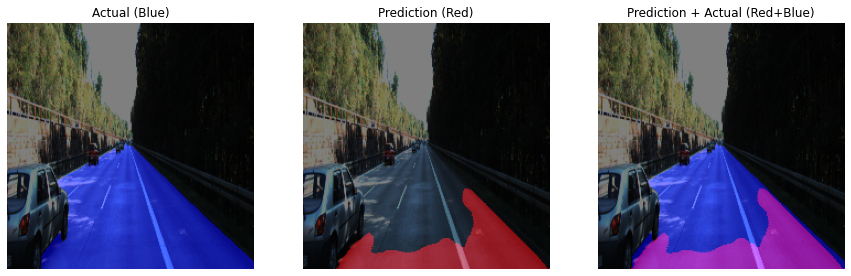

IoU : 0.397813


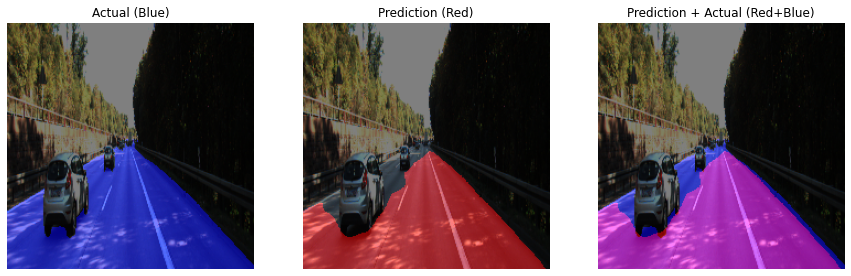

IoU : 0.875491


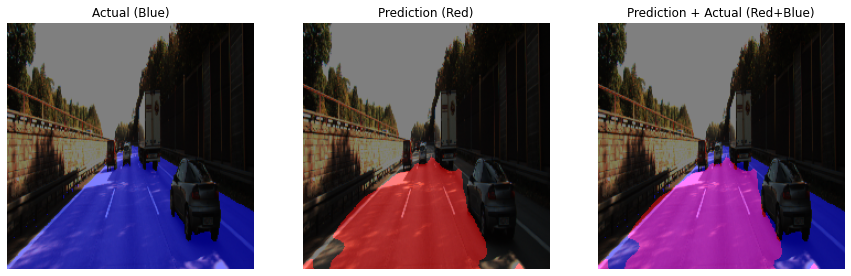

IoU : 0.711413


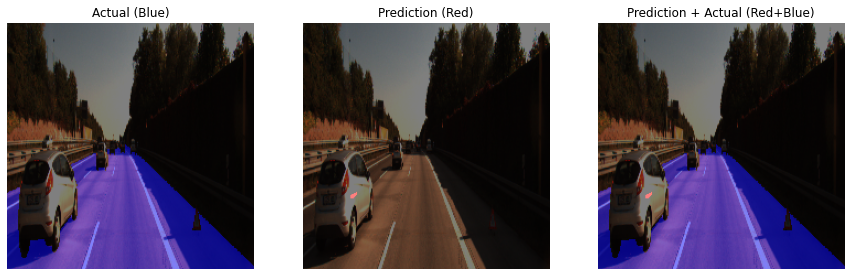

IoU : 0.000000


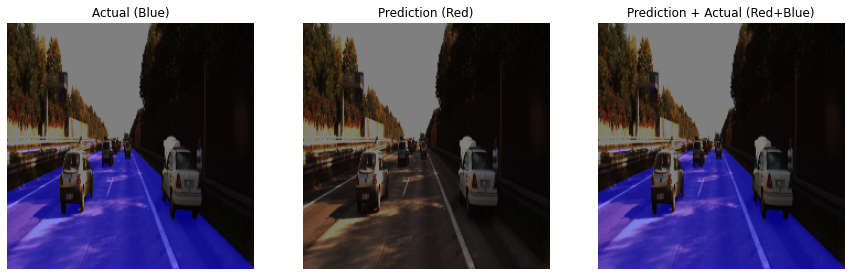

IoU : 0.000000


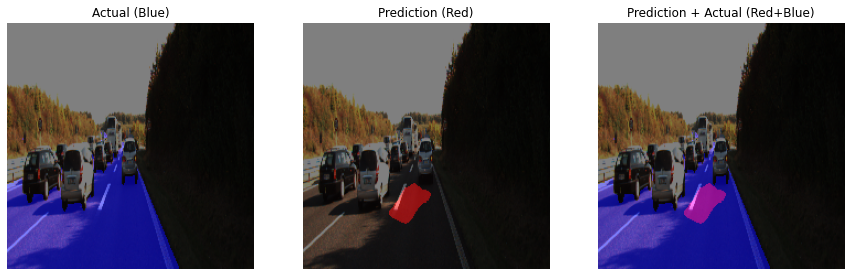

IoU : 0.070616


In [166]:
# 정성 평가 - U-net
for i in range(200-30, 200):
    origin_img, output, prediction, target = get_output(
         model, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    
    evauate(origin_img, output, prediction, target)

In [168]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))[0]
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
#     output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return origin_img, output, prediction, target
    else:
        return origin_img, output, prediction, _

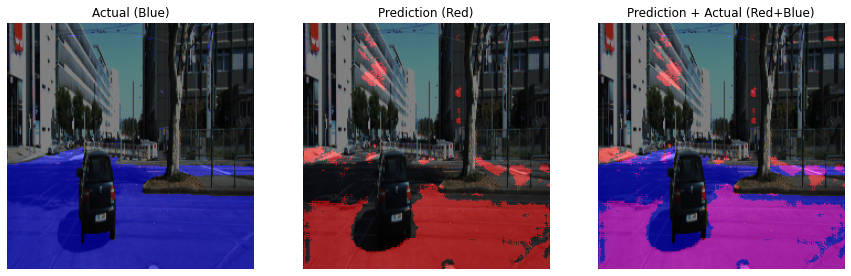

IoU : 0.613523


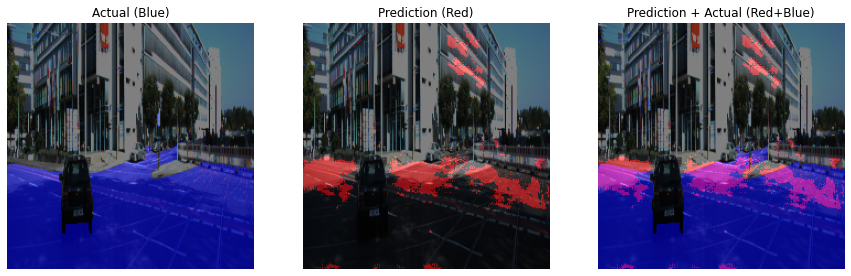

IoU : 0.160834


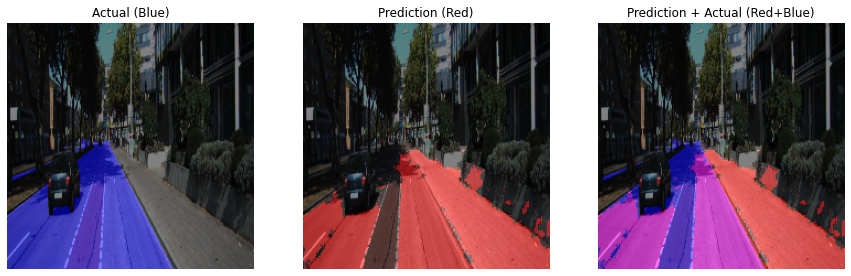

IoU : 0.435403


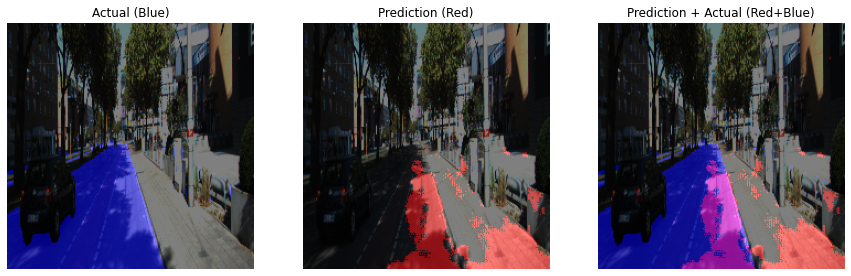

IoU : 0.225484


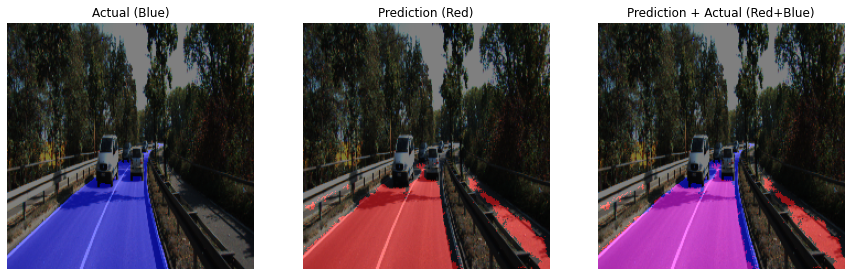

IoU : 0.773424


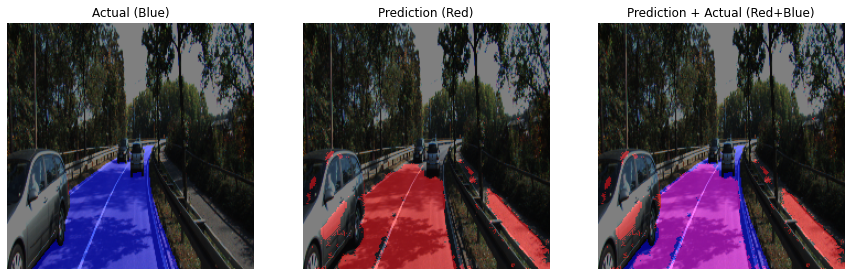

IoU : 0.663430


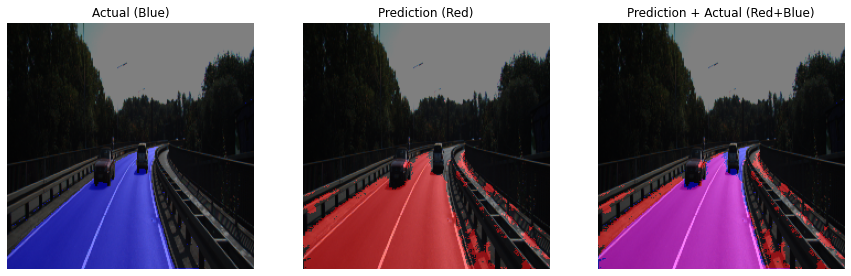

IoU : 0.777272


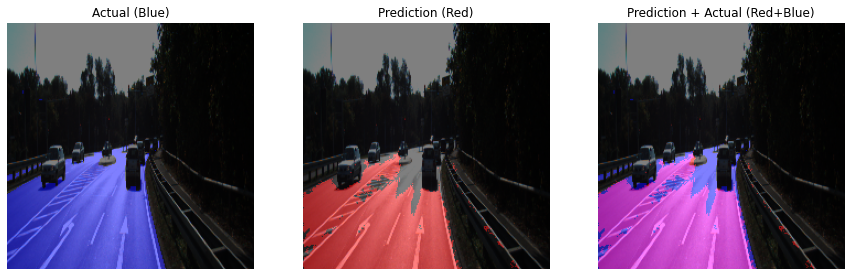

IoU : 0.838813


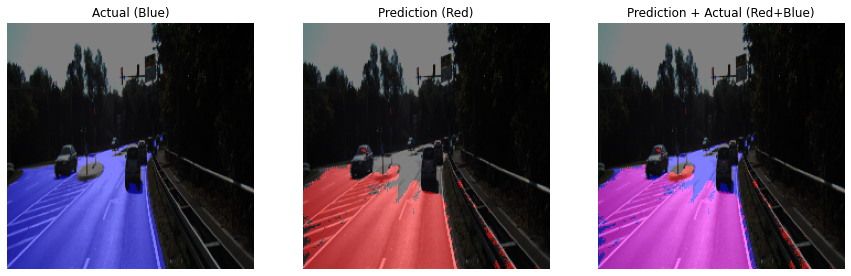

IoU : 0.818844


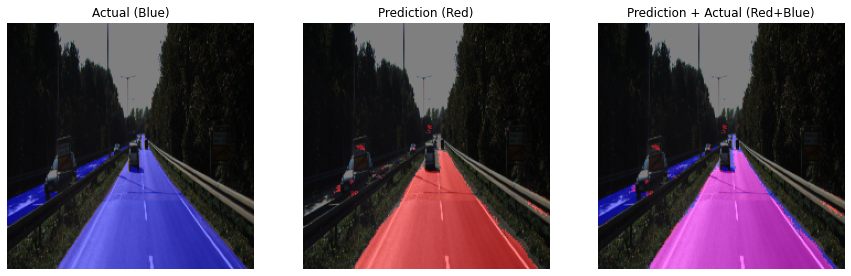

IoU : 0.847946


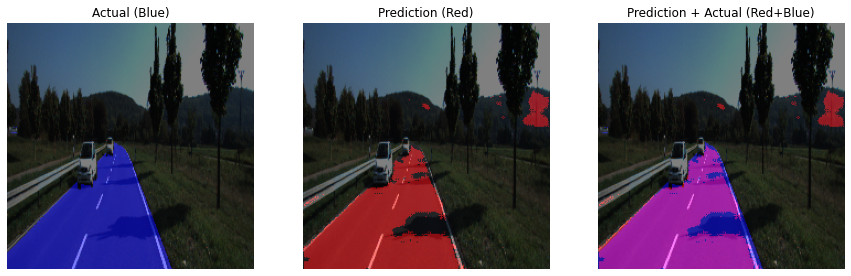

IoU : 0.793056


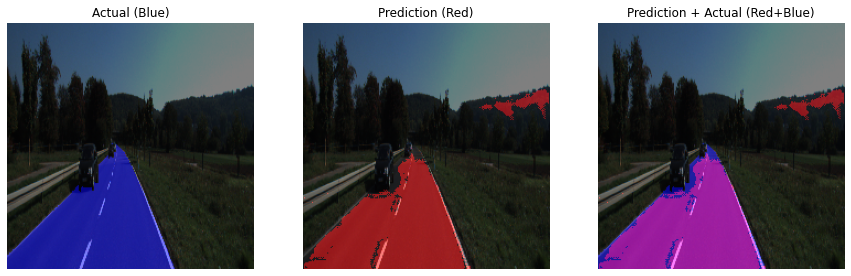

IoU : 0.858231


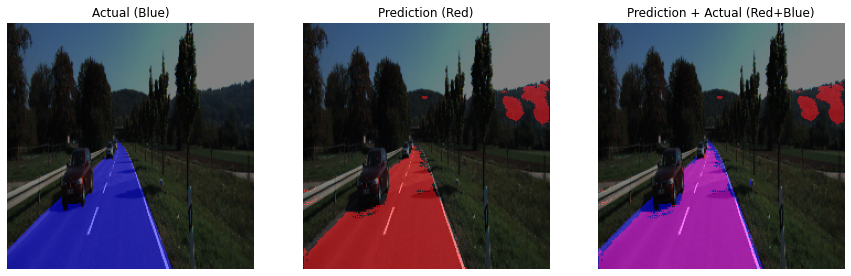

IoU : 0.824215


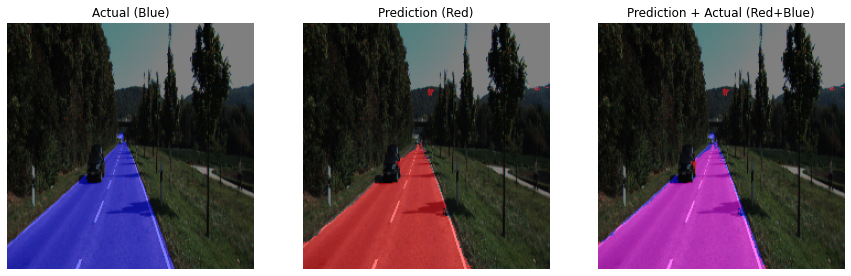

IoU : 0.948181


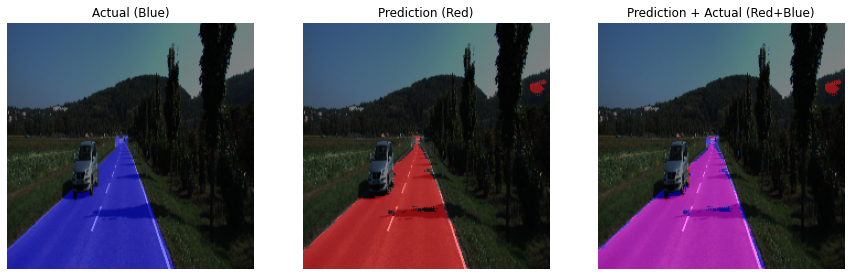

IoU : 0.921295


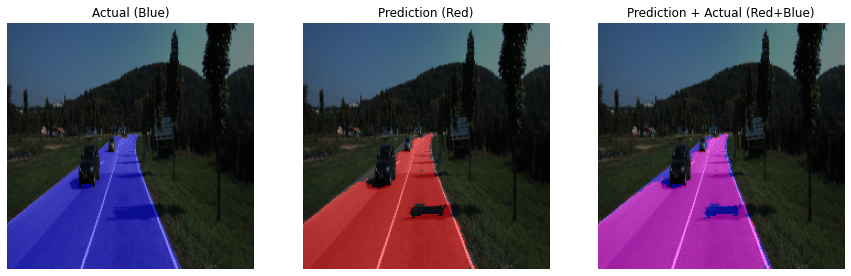

IoU : 0.932890


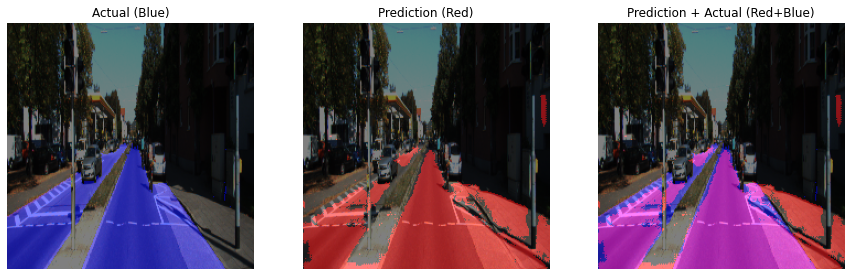

IoU : 0.690265


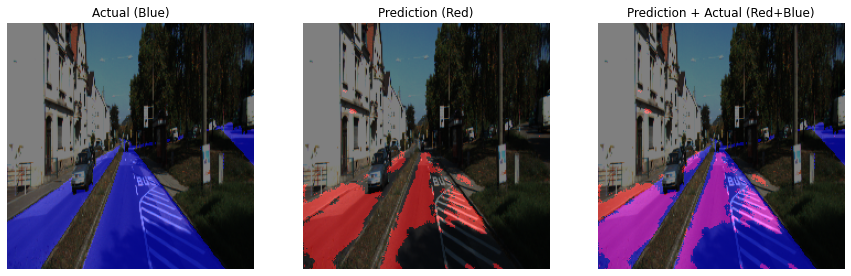

IoU : 0.451869


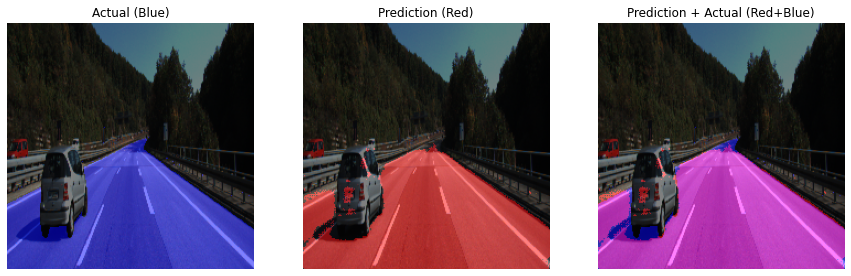

IoU : 0.930985


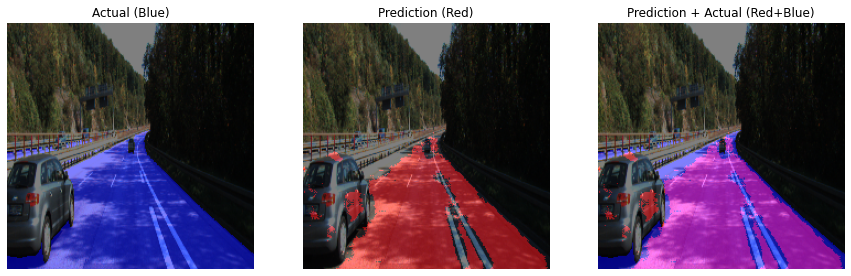

IoU : 0.750152


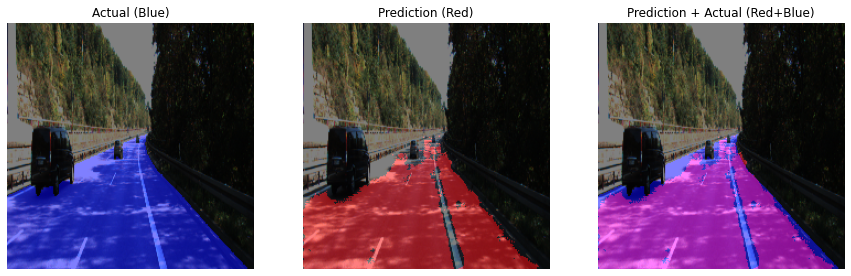

IoU : 0.853056


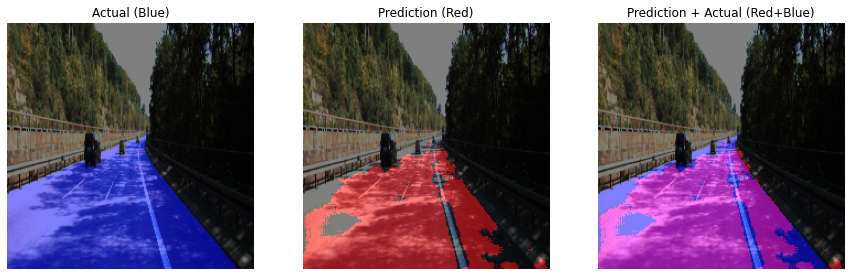

IoU : 0.783920


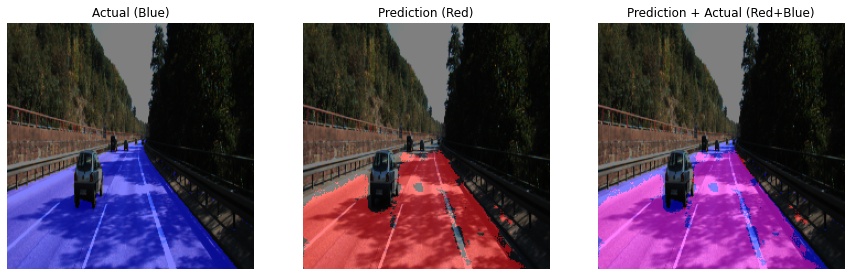

IoU : 0.864945


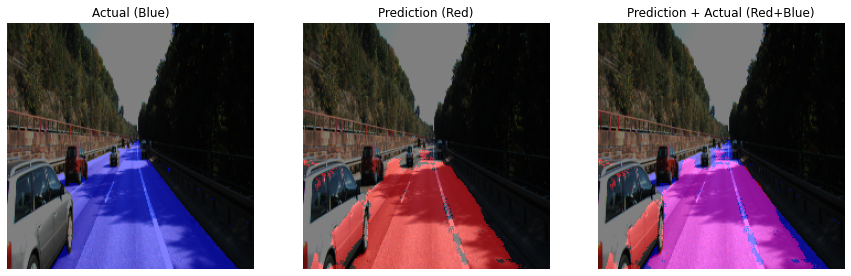

IoU : 0.783935


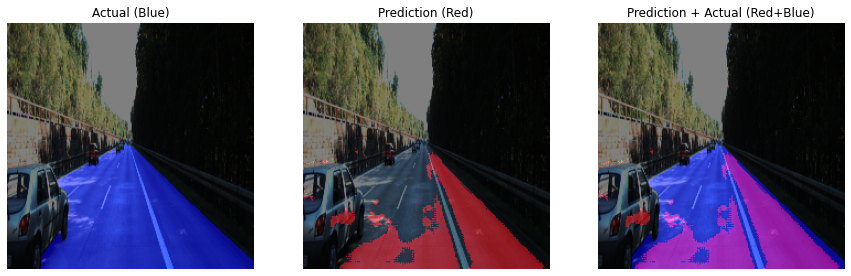

IoU : 0.512890


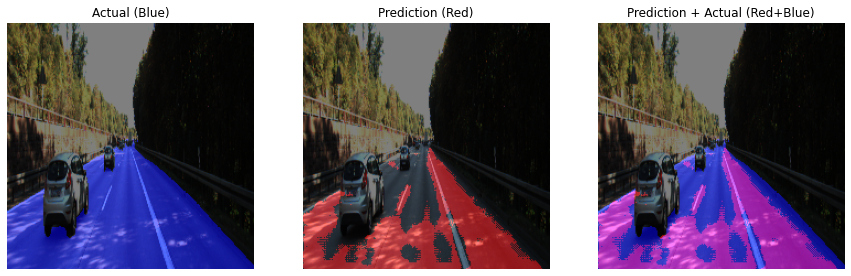

IoU : 0.594609


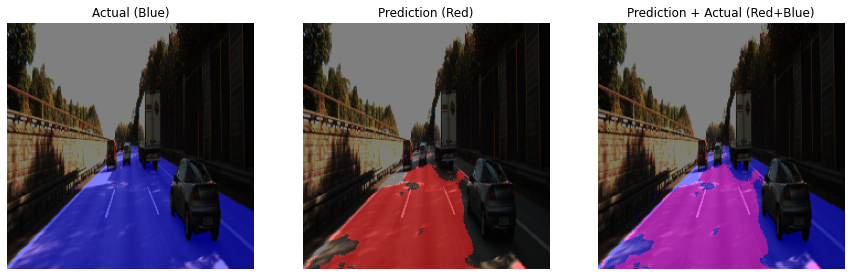

IoU : 0.624945


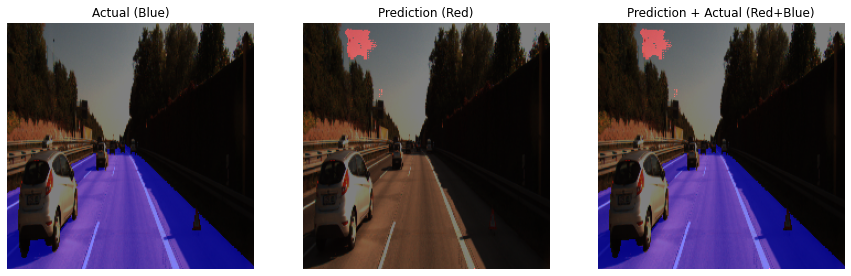

IoU : 0.000072


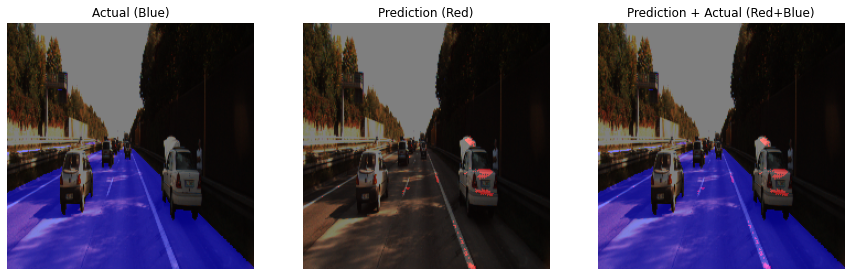

IoU : 0.005573


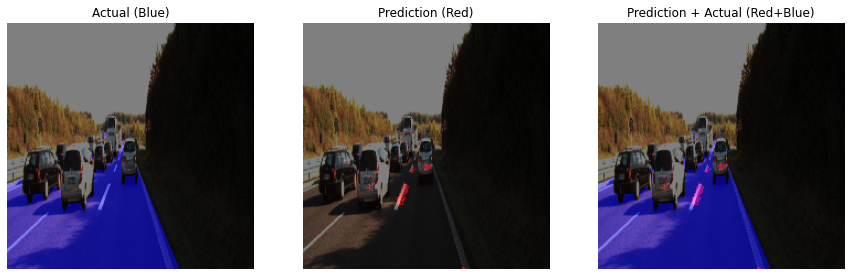

IoU : 0.012432


In [133]:
# 정성 평가
for i in range(200-30, 200):
    origin_img, output, prediction, target = get_output(
         model_unet_plus_plus, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    
    evauate(origin_img, output, prediction, target)

In [170]:
# 두 모델 전부 인도를 잘못 인식하는 경우가 발생한다.
# 고속도로와 같이 도로와 자동차가 주로 있는 이미지에서는 비교적 잘 수행하지만, 건물이 있을 경우 잘 인식하지 못한다.
# 일부 이미지에서는 도로인식을 대부분 하지 못하는 현상들도 발생한다.
# 개인적인 생각으로는 모델이 train, val_set에 과적합 되었을 수도 있을 것 같다는 생각을 했다.(훈련 그래프 및 베스트 모델 참고)
# 모델을 Best Model 보다는 내가 생각하는 전환점 부근 그리고 여러 구간별로 테스트 하는 것이 필요하다.

# U-Net 기준 최적 모델을 찾아보자.

In [171]:
# 위 훈련그래프를 보면 20 에포크 부근에서 전환된 것을 확인할 수 있다.
# 그리고 전환점인 20에포크와 베스트 모델의 중간 지점인 40에포크를 평가해보자.
# 후보1 : 20에포크 가중치
# 후보2 : 40에포크 가중치
# 후보3 : 베스트 모델

In [172]:
# 20에포크 가중치

# 훈련된 모델 불러오기
model = build_model()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy', metrics=[iou_metric, accuracy_metric, false_positive_metric])
model.load_weights('./weights_Unet_epoch_20.h5')

In [174]:
# test_generator에서 모든 라벨 데이터만 가져오기
test_labels = []

for i in range(len(test_generator)):
    _, labels = test_generator[i]  # 입력(X) 무시, 라벨(Y)만 저장
    test_labels.append(labels)

# NumPy 배열로 변환
test_labels = np.concatenate(test_labels, axis=0)
test_labels = test_labels[:30, :, :]

pred = model.predict(test_generator)
pred = np.array(pred).reshape(32, 224, 224)
pred = pred[:30, :, :]

print('iou:', iou_metric(y_true=test_labels, y_pred=pred))
print('accuracy:', accuracy_metric(y_true=test_labels, y_pred=pred))
print('false_positive_metric:', false_positive_metric(y_true=test_labels, y_pred=pred))

iou: tf.Tensor(0.6747695, shape=(), dtype=float32)
accuracy: tf.Tensor(0.9085173, shape=(), dtype=float32)
false_positive_metric: tf.Tensor(0.027011847, shape=(), dtype=float32)


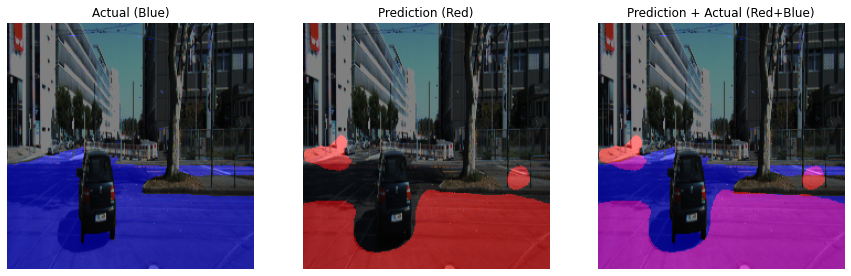

IoU : 0.671211


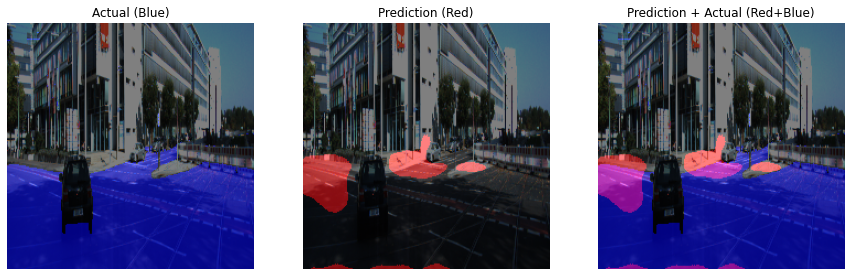

IoU : 0.104180


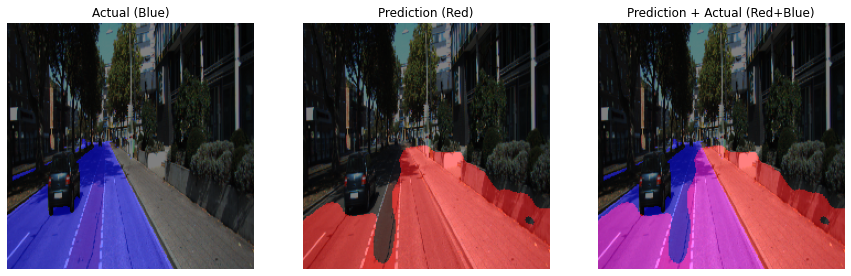

IoU : 0.419351


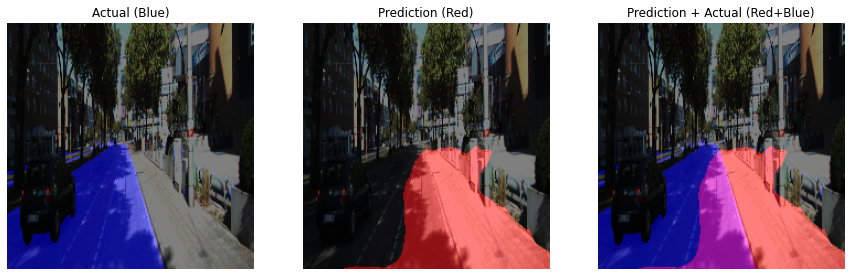

IoU : 0.233690


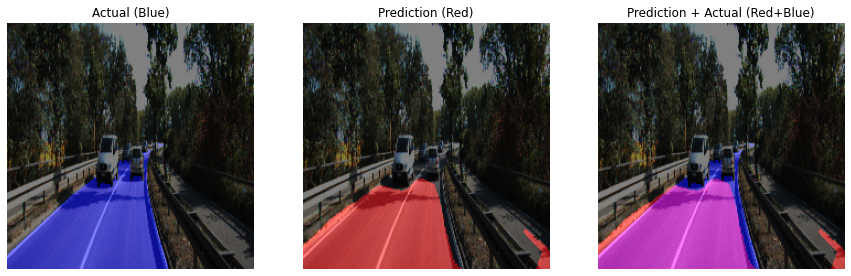

IoU : 0.814779


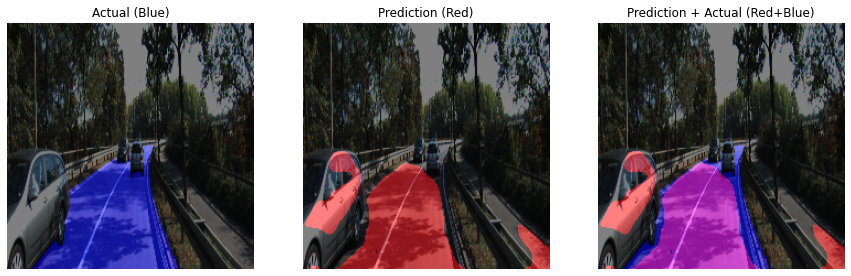

IoU : 0.612420


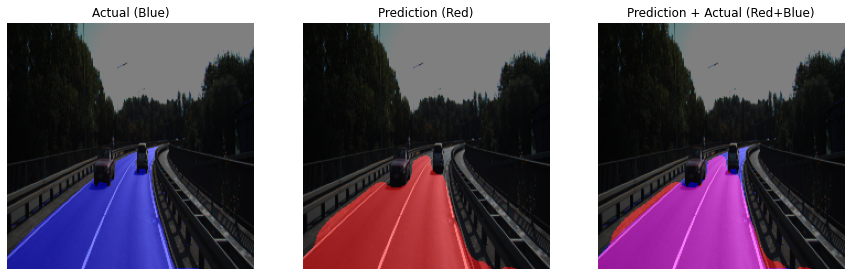

IoU : 0.902999


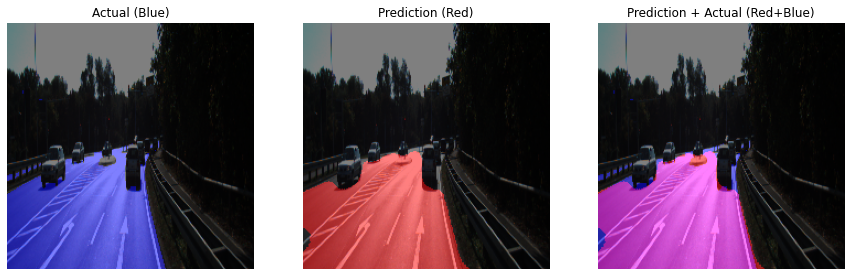

IoU : 0.928943


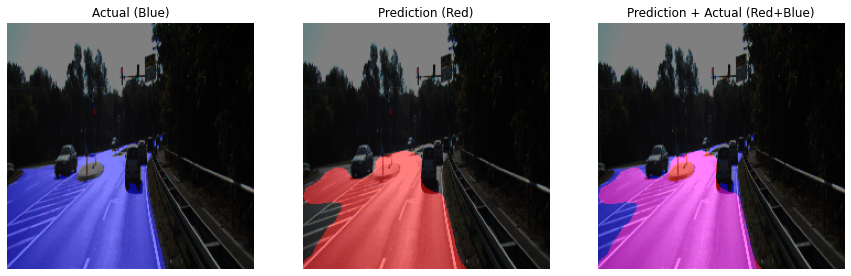

IoU : 0.835311


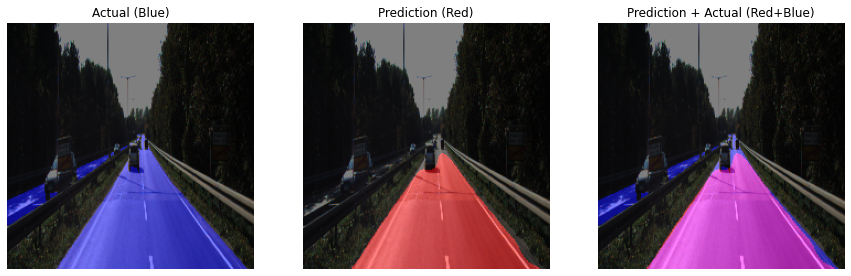

IoU : 0.856719


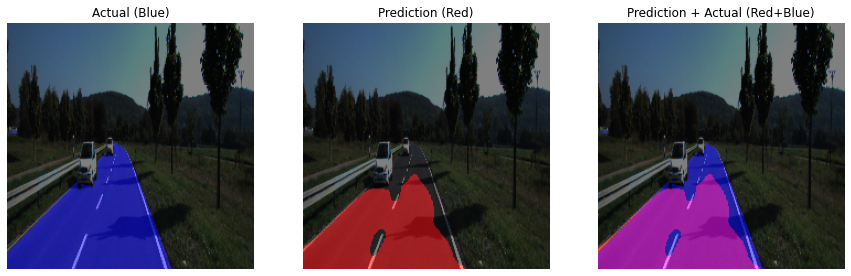

IoU : 0.770971


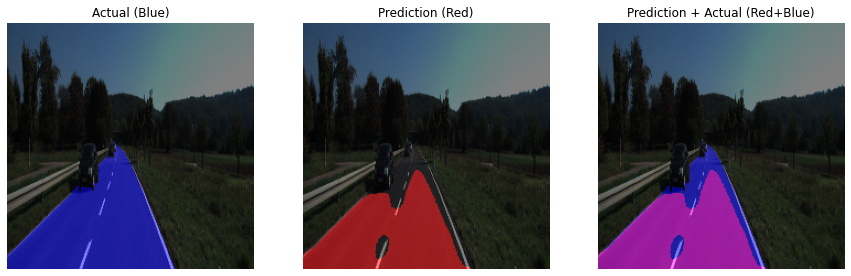

IoU : 0.799411


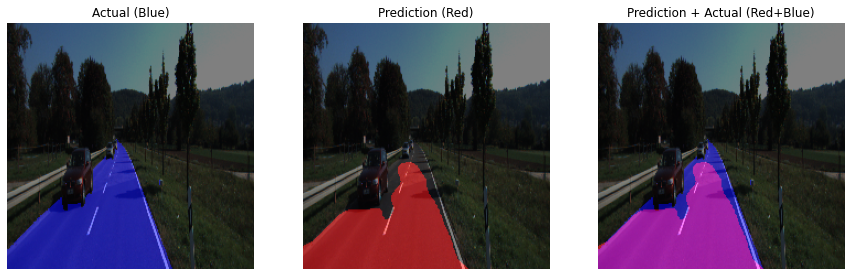

IoU : 0.832557


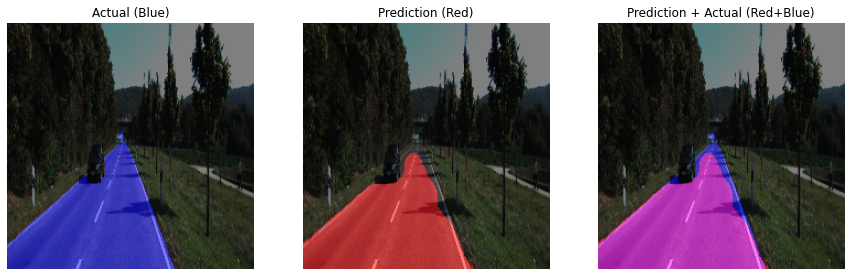

IoU : 0.919669


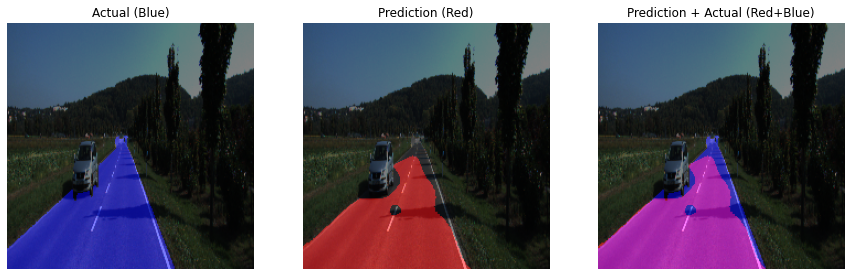

IoU : 0.873174


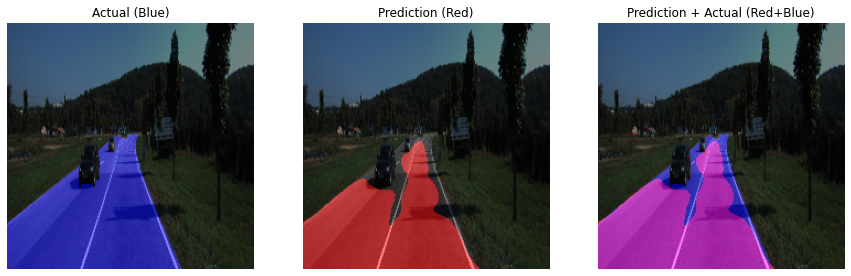

IoU : 0.858895


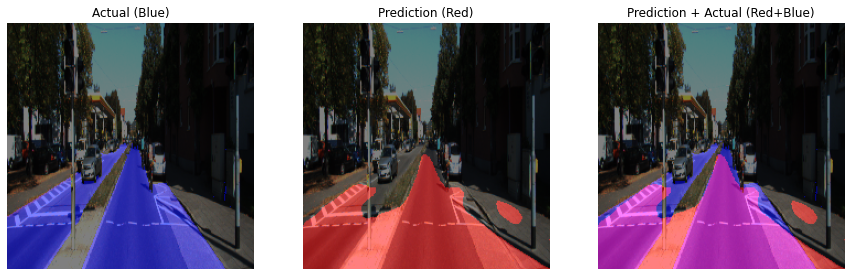

IoU : 0.726752


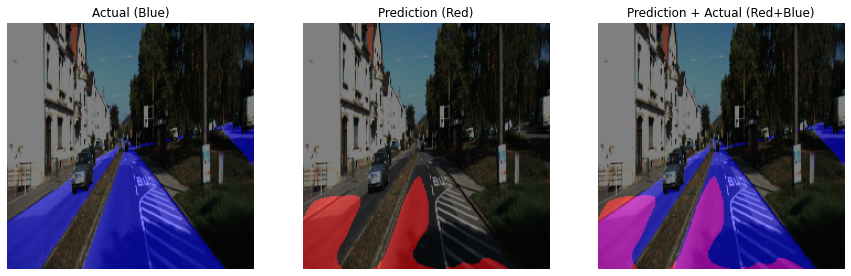

IoU : 0.385049


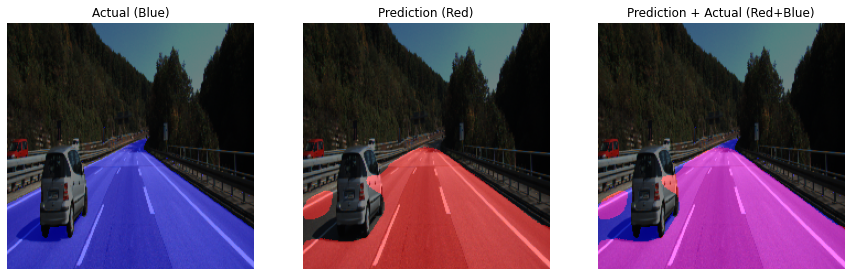

IoU : 0.905289


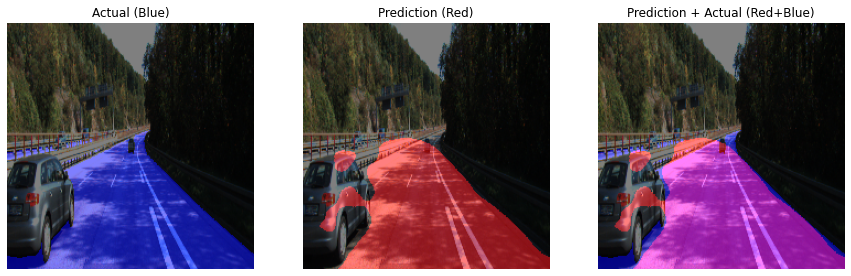

IoU : 0.824680


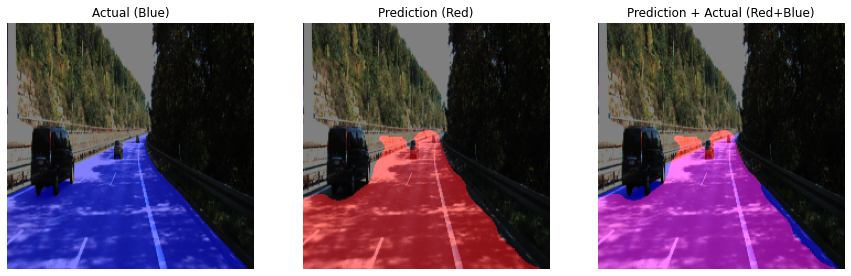

IoU : 0.898570


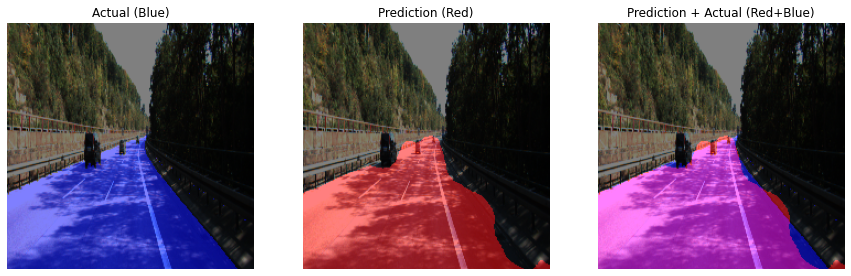

IoU : 0.928528


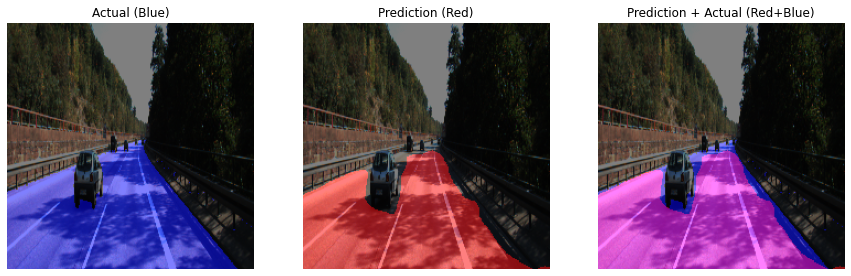

IoU : 0.892970


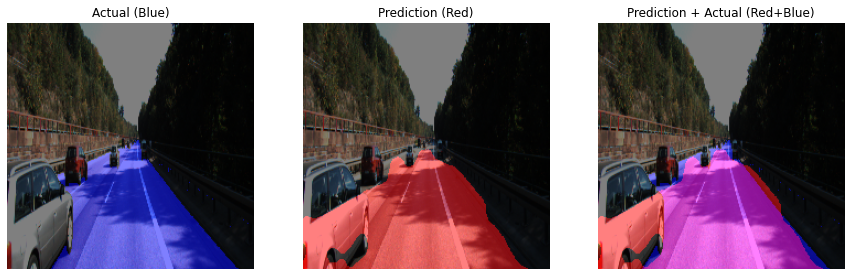

IoU : 0.734732


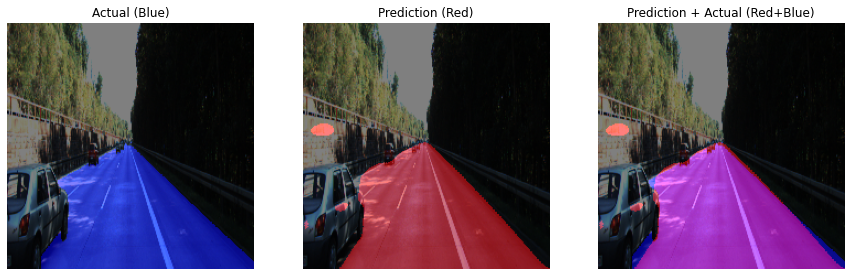

IoU : 0.914675


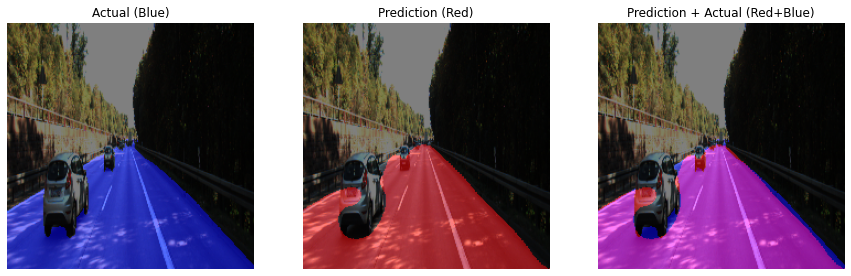

IoU : 0.912287


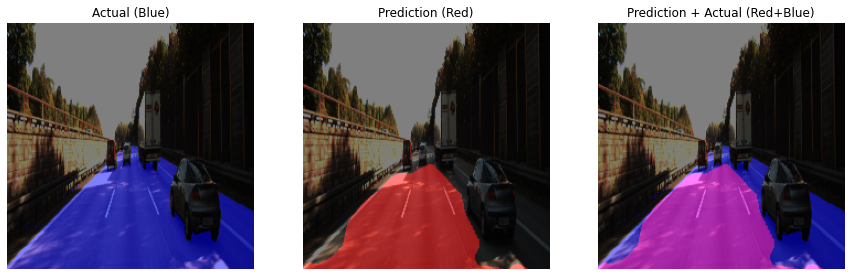

IoU : 0.676395


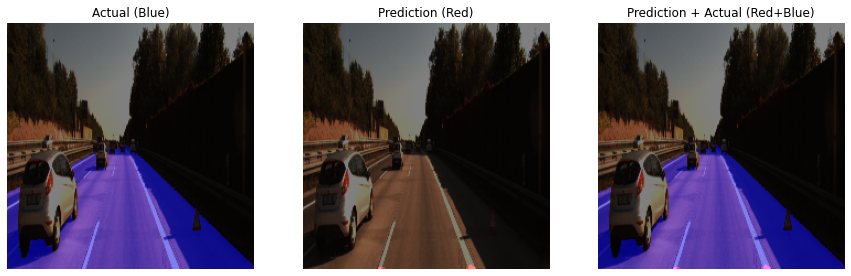

IoU : 0.002757


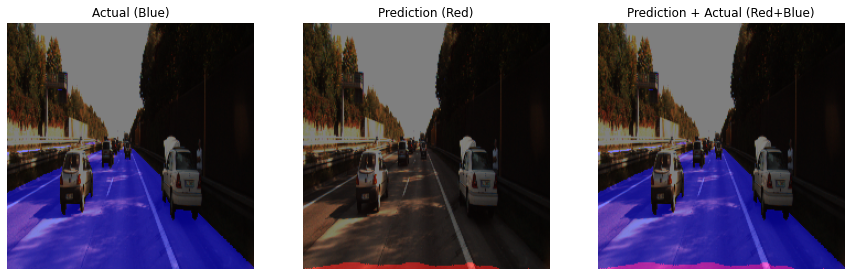

IoU : 0.045630


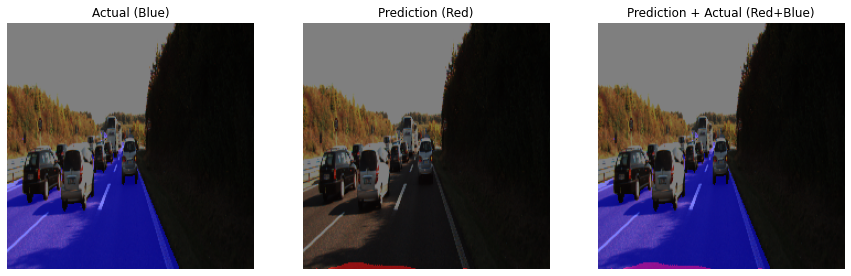

IoU : 0.027080


In [175]:
# get_output을 좀 더 확장해서 output, prediction, target을 함께 리턴
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = np.array(output).reshape(224, 224)
    output = (output>=0.5).astype(np.uint8)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
    prediction = output/255   # 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
#     output.show()   # 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역

        return origin_img, output, prediction, target
    else:
        return origin_img, output, prediction, _
    
# 정성 평가
for i in range(200-30, 200):
    origin_img, output, prediction, target = get_output(
         model, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )
    
    evauate(origin_img, output, prediction, target)

In [ ]:
# 아 지금 다시 생각해보면.. 훈려에 사용된 샘플개수가 200개도 채 되지 않는다...
# 어쩌면 당연한 결과이다..
# 훈련할 샘플 개수를 더욱 확보하면 일반화 성능이 높아질 것 같다. # 하지만 시간관계상 여기까지..ㅠ